# Tutorial for CODEX CRC dataset
Need additional packages: scanpy seaborn

### Load the packages

In [2]:
import os
import scanpy as sc
import pandas as pd
import numpy as np
import anndata as ad
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.lines import Line2D
import matplotlib.lines as mlines

from Harmonics import *

import warnings
warnings.filterwarnings("ignore")

sc.settings.verbosity = 0
sc.settings.set_figure_params(dpi=30, dpi_save=500)

from matplotlib import rcParams
rcParams["figure.dpi"] = 30
rcParams["savefig.dpi"] = 500

In [3]:
data_dir = '../../../Data/Spatial/Proteomics/CODEX_CRC_Schurch2020/processed/'
save_dir = '../../results/CODEX_CRC_Schurch2020/Harmonics/'
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

Define the function to change p values to corresponding star representation, used to show the results of additional tests implemented in Harmonics

In [4]:
def p2stars(p):
    if p < 0.001:
        return '***'
    elif p < 0.01:
        return '**'
    elif p < 0.05:
        return '*'
    else:
        return ''

### Load dataset
Three slices with unidentified immune cells exceeding 50% of total cells are removed

Use DII group as the control group and CLR group as the case group

In [5]:
fname_list = np.loadtxt(data_dir + f"file_name_list.txt", dtype=str, delimiter=" ").tolist()

adata_list = []
slice_name_list = []
cond_list = []
cond_name_list = []
for fname in fname_list:
    adata = ad.read_h5ad(data_dir + fname + '.h5ad')

    # adata = adata[adata.obs['ClusterName'] != 'undefined', :].copy()  
    
    # filter out slices with other immune cell comprising over 50% of cells
    other_prop = np.sum(adata.obs['ClusterName'] == 'immune cells').astype(int) / adata.shape[0]
    if other_prop > 0.5:
        print(f'Filtering out sample {fname} due to high proportion of unidentified immune cells ({other_prop*100:.2f}%)')
        continue

    patient = adata.obs['patients'][0]
    group = adata.obs['groups'][0]
    if group == '1': # group 1: CLR  
        cond_list.append(adata)
        cond_name_list.append(fname)
    else: # group 2: DII
        adata_list.append(adata)
        slice_name_list.append(fname)

Filtering out sample reg023_A_patient12_group1 due to high proportion of unidentified immune cells (53.36%)
Filtering out sample reg064_A_patient32_group1 due to high proportion of unidentified immune cells (51.93%)
Filtering out sample reg066_A_patient33_group1 due to high proportion of unidentified immune cells (51.50%)


### Run model

Instantiate Harmonics

In [ ]:
model = Harmonics_Model(adata_list,  # the list of AnnData objects for the control group
                        slice_name_list,  # the list of slice names for the control group
                        cond_list=cond_list,  # the list of AnnData objects for the case group
                        cond_name_list=cond_name_list,  # the list of slice names for the case group
                        concat_label='slice_name',  # the label in .obs to indicate different slices
                        seed=1234,  # default
                        parallel=True,  # default
                        verbose=True,  # default
                        )

Control set comprises 72 slices, 143062 cells/spots in total.
Condition set comprises 65 slices, 103174 cells/spots in total.


Preprocess the data (Generating the connection graph and calculating neighborhood cell type destribution for cells)

In [ ]:
model.preprocess(ct_key='ClusterName',  # the label in .obs to indicate cell types
                 spatial_key='spatial',  # default
                 method='joint',  # default
                 n_step=3,  # default
                 n_neighbors=20,  # default
                 cut_percentage=99,  # default
                 )

Generating Delaunay neighbor graph...


100%|██████████| 137/137 [00:02<00:00, 58.60it/s]


All done!

Performing graph completion...


100%|██████████| 137/137 [00:22<00:00,  6.22it/s]


All done!

The cell types of interest are:
B cells
CD11b+ monocytes
CD11b+CD68+ macrophages
CD11c+ DCs
CD163+ macrophages
CD3+ T cells
CD4+ T cells
CD4+ T cells CD45RO+
CD4+ T cells GATA3+
CD68+ macrophages
CD68+ macrophages GzmB+
CD68+CD163+ macrophages
CD8+ T cells
NK cells
Tregs
adipocytes
granulocytes
immune cells
immune cells / vasculature
lymphatics
nerves
plasma cells
smooth muscle
stroma
tumor cells
tumor cells / immune cells
undefined
vasculature

Generating one-hot matrix...


100%|██████████| 137/137 [00:00<00:00, 384.63it/s]


All done!

Dataset comprises 28 cell types.

Calculating cell type distribution for microenvironments...
Microenvironments comprise 40.36 cells/spots on average. 
Minimum: 20, Maximum: 104



Perform overclustered initialization on the cell type distributions of cell neighborhoods for the **control group**. Resulting in *Qmax* niches. The distributions of niches are also computed.

In [ ]:
model.initialize_clusters(dim_reduction=True,  # default
                          explained_var=None,  # default
                          n_components=None,  # default
                          n_components_max=100,  # default
                          standardize=True,  # default
                          method='kmeans',  # default 
                          Qmax=20, 
                          )

Performing dimension reduction...
Returning 28 principal components.

Initializing niches...
20 initial niches defined.



Perform hierarchical distribution matching for the **control group** to reduce the niche number to no more than *Qmin*. This step results in niche assignment under a sequence of different niche numbers (usually from *Qmax* to *Qmin*).

In [ ]:
model.hier_dist_match(assign_metric='jsd',  # default
                      weighted_merge=True,  # default
                      max_iters=100,  # default 
                      tol=1e-4,  # default 
                      test_kmeans=False,  # default
                      Qmin=2,  # default
                      )

Starting from 20 cell niches...

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]


 52%|█████▏    | 52/100 [00:12<00:11,  4.31it/s]


Distribution of cell niches (centers) converge at iteration 53.
20 cell niches left.
Merging cell niche 2 and cell niche 17...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 18, 19]


  9%|▉         | 9/100 [00:01<00:20,  4.55it/s]


Distribution of cell niches (centers) converge at iteration 10.
19 cell niches left.
Merging cell niche 8 and cell niche 11...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15, 16, 18, 19]


 25%|██▌       | 25/100 [00:05<00:15,  4.89it/s]


Distribution of cell niches (centers) converge at iteration 26.
18 cell niches left.
Merging cell niche 3 and cell niche 12...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15, 16, 18, 19]


 30%|███       | 30/100 [00:06<00:15,  4.62it/s]


Converge at iteration 31.
17 cell niches left.
Merging cell niche 3 and cell niche 5...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 13, 14, 15, 16, 18, 19]


 24%|██▍       | 24/100 [00:04<00:15,  4.97it/s]


Converge at iteration 25.
16 cell niches left.
Merging cell niche 19 and cell niche 14...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 13, 15, 16, 18, 19]


  7%|▋         | 7/100 [00:01<00:19,  4.77it/s]


Distribution of cell niches (centers) converge at iteration 8.
15 cell niches left.
Merging cell niche 3 and cell niche 8...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 4, 6, 7, 9, 10, 13, 15, 16, 18, 19]


 14%|█▍        | 14/100 [00:02<00:16,  5.24it/s]


Distribution of cell niches (centers) converge at iteration 15.
14 cell niches left.
Merging cell niche 1 and cell niche 10...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 4, 6, 7, 9, 13, 15, 16, 18, 19]


 11%|█         | 11/100 [00:02<00:17,  5.03it/s]


Distribution of cell niches (centers) converge at iteration 12.
13 cell niches left.
Merging cell niche 4 and cell niche 3...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 4, 6, 7, 9, 13, 15, 16, 18, 19]


  9%|▉         | 9/100 [00:01<00:17,  5.33it/s]


Distribution of cell niches (centers) converge at iteration 10.
12 cell niches left.
Merging cell niche 16 and cell niche 6...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 4, 7, 9, 13, 15, 16, 18, 19]


  7%|▋         | 7/100 [00:01<00:17,  5.22it/s]


Distribution of cell niches (centers) converge at iteration 8.
11 cell niches left.
Merging cell niche 13 and cell niche 4...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 7, 9, 13, 15, 16, 18, 19]


 84%|████████▍ | 84/100 [00:14<00:02,  5.94it/s]


Distribution of cell niches (centers) converge at iteration 85.
10 cell niches left.
Merging cell niche 19 and cell niche 13...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 7, 9, 15, 16, 18, 19]


 19%|█▉        | 19/100 [00:03<00:13,  5.92it/s]


Converge at iteration 20.
9 cell niches left.
Merging cell niche 1 and cell niche 18...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 7, 9, 15, 16, 19]


 11%|█         | 11/100 [00:01<00:15,  5.57it/s]


Distribution of cell niches (centers) converge at iteration 12.
8 cell niches left.
Merging cell niche 16 and cell niche 0...
Done!

Assigning cells to cell niche...
Current state: [1, 2, 7, 9, 15, 16, 19]


  9%|▉         | 9/100 [00:01<00:16,  5.49it/s]


Distribution of cell niches (centers) converge at iteration 10.
7 cell niches left.
Merging cell niche 16 and cell niche 15...
Done!

Assigning cells to cell niche...
Current state: [1, 2, 7, 9, 16, 19]


  9%|▉         | 9/100 [00:01<00:15,  5.96it/s]


Distribution of cell niches (centers) converge at iteration 10.
6 cell niches left.
Merging cell niche 2 and cell niche 7...
Done!

Assigning cells to cell niche...
Current state: [1, 2, 9, 16, 19]


  4%|▍         | 4/100 [00:00<00:17,  5.54it/s]


Distribution of cell niches (centers) converge at iteration 5.
5 cell niches left.
Merging cell niche 19 and cell niche 1...
Done!

Assigning cells to cell niche...
Current state: [2, 9, 16, 19]


 13%|█▎        | 13/100 [00:01<00:12,  6.73it/s]


Distribution of cell niches (centers) converge at iteration 14.
4 cell niches left.
Merging cell niche 9 and cell niche 19...
Done!

Assigning cells to cell niche...
Current state: [2, 9, 16]


  7%|▋         | 7/100 [00:01<00:13,  6.83it/s]


Distribution of cell niches (centers) converge at iteration 8.
3 cell niches left.
Merging cell niche 16 and cell niche 9...
Done!

Assigning cells to cell niche...
Current state: [2, 16]


  8%|▊         | 8/100 [00:01<00:12,  7.51it/s]

Distribution of cell niches (centers) converge at iteration 9.
2 cell niches left.
Niche count no more than 2.

Finished!



Automatically define the most appropriate number of basic cell niches based on minJSD score for the **control group**. The results are saved in .obs[niche_key]

Automatically selecting best solution...
Recommended number of niches are [4]
Selecting 4 niches as the best solution.


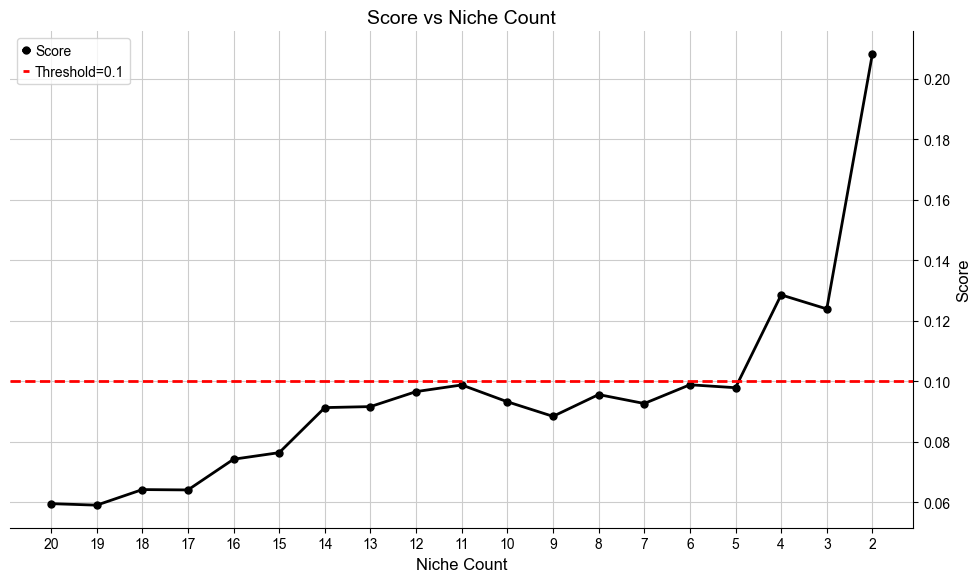

Done!



In [ ]:
adata_list, adata_concat = model.select_solution(n_niche=None,  # default
                                                 niche_key='niche_label',  # default 
                                                 auto=True,  # default
                                                 metric='jsd',  # default
                                                 threshold=0.1,  # default
                                                 return_adata=True,  # default
                                                 plot=True,  # default
                                                 save=False,  # default
                                                 fig_size=(10, 6),  # default
                                                 save_dir=save_dir, 
                                                 file_name=f'score_vs_nichecount_basic.pdf',
                                                 )

Perform overclustered initialization on the cell type distributions of cell neighborhoods for the **case group**. Resulting in *Rmax* new niches. The distributions of new niches are also computed.

In [ ]:
model.initialize_clusters_cond(assign_metric='jsd',  # default
                               threshold=0.1,  # default
                               min_cell_per_niche=100,  # default
                               dim_reduction=True,  # default
                               explained_var=None,  # default
                               n_components=None,  # default
                               n_components_max=100,  # default
                               standardize=True,  # default 
                               method='kmeans',  # default 
                               Rmax=10,  # default 
                               )

Assigning cells to fixed niches...
13347 out of 103174 cells are assigned to fixed niches.

Performing dimension reduction...
Returning 28 principal components.

Initializing niches...
10 new niches defined.



Perform hierarchical distribution matching for the **case group** to reduce the niche number to 0. This step results in niche assignment under a sequence of different niche numbers (usually from *Rmax* to 0).

In [ ]:
model.hier_dist_match_cond(assign_metric='jsd',  # default 
                           weighted_merge=True,  # default 
                           max_iters=100,  # default  
                           tol=1e-4,  # default  
                           )

Starting from 10 new cell niches...

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]


 25%|██▌       | 25/100 [00:04<00:12,  6.22it/s]


Distribution of cell niches (centers) converge at iteration 26.
10 new cell niches left.
Merging new cell niche 4 into basic cell niche 3...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13]


  9%|▉         | 9/100 [00:01<00:15,  6.04it/s]


Distribution of cell niches (centers) converge at iteration 10.
9 new cell niches left.
Merging new cell niche 5 into basic cell niche 0...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 6, 7, 8, 9, 10, 11, 12, 13]


  3%|▎         | 3/100 [00:00<00:15,  6.12it/s]


Distribution of cell niches (centers) converge at iteration 4.
8 new cell niches left.
Merging new cell niche 9 into basic cell niche 3...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 6, 7, 8, 10, 11, 12, 13]


 10%|█         | 10/100 [00:01<00:12,  7.29it/s]


Distribution of cell niches (centers) converge at iteration 11.
7 new cell niches left.
Merging new cell niche 7 into basic cell niche 2...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 6, 8, 10, 11, 12, 13]


  6%|▌         | 6/100 [00:00<00:11,  7.86it/s]


Distribution of cell niches (centers) converge at iteration 7.
6 new cell niches left.
Merging new cell niche 8 into basic cell niche 3...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 6, 10, 11, 12, 13]


 18%|█▊        | 18/100 [00:02<00:09,  8.24it/s]


Distribution of cell niches (centers) converge at iteration 19.
5 new cell niches left.
Merging new cell niche 6 into basic cell niche 3...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 10, 11, 12, 13]


 35%|███▌      | 35/100 [00:03<00:07,  9.14it/s]


Distribution of cell niches (centers) converge at iteration 36.
4 new cell niches left.
Merging new cell niche 10 into basic cell niche 3...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 11, 12, 13]


 27%|██▋       | 27/100 [00:02<00:07,  9.66it/s]


Distribution of cell niches (centers) converge at iteration 28.
3 new cell niches left.
Merging new cell niche 11 into basic cell niche 3...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 12, 13]


  1%|          | 1/100 [00:00<00:14,  6.72it/s]


Distribution of cell niches (centers) converge at iteration 2.
2 new cell niches left.
Merging new cell niche 12 and new cell niche 13...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3, 12]


  3%|▎         | 3/100 [00:00<00:09,  9.85it/s]


Distribution of cell niches (centers) converge at iteration 4.
1 new cell niches left.
Merging new cell niche 12 into basic cell niche 3...
Done!

Assigning cells to cell niche...
Current state: [0, 1, 2, 3]
No new cell niche, all cells assigned to basic niches.
0 new cell niches left.
No new cell niche left.

Finished!



Automatically define the most appropriate number of condition-specific niches based on minJSD score for the **case group**. The results of niche assignments are saved in .obs[niche_key] and .obs[csn_label]. All basic cell niches are named "basic" in .obs[csn_label] and condition-specific niches start with a prefix "R".

Automatically selecting best solution...
Recommended number of condition specific niches are [2]
Selecting 2 new niches as the best solution.


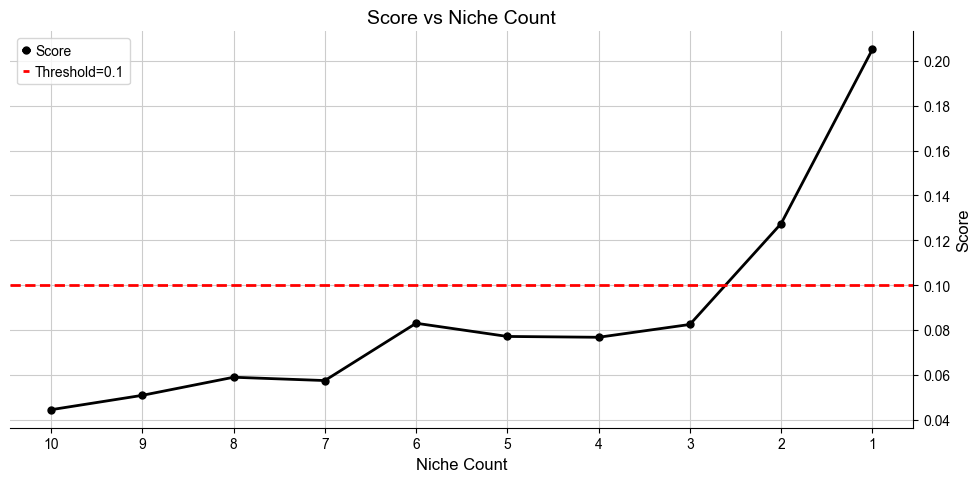

Done!



In [ ]:
cond_list, cond_concat = model.select_solution_cond(n_csn=None,  # default 
                                                    niche_key='niche_label',  # default
                                                    csn_key='csn_label',  # default
                                                    auto=True,  # default 
                                                    metric='jsd',  # default
                                                    threshold=0.1,  # default
                                                    return_adata=True,  # default
                                                    plot=True,  # default 
                                                    save=False,  # default
                                                    fig_size=None,  # default
                                                    save_dir=save_dir, 
                                                    file_name='score_vs_nichecount_cond.pdf',
                                                    )

Save and reload the results

In [ ]:
adata_concat.write_h5ad(save_dir + 'Harmonics_basic_result_0.h5ad')
cond_concat.write_h5ad(save_dir + 'Harmonics_cond_result_0.h5ad')

In [ ]:
adata_concat = ad.read_h5ad(save_dir + 'Harmonics_basic_result_0.h5ad')
cond_concat = ad.read_h5ad(save_dir + 'Harmonics_cond_result_0.h5ad')

for i, slice_name in enumerate(slice_name_list):
    adata = adata_concat[adata_concat.obs['slice_name'] == slice_name, :].copy()
    adata_list[i] = adata
for i, slice_name in enumerate(cond_name_list):
    adata = cond_concat[cond_concat.obs['slice_name'] == slice_name, :].copy()
    cond_list[i] = adata

In [ ]:
adata_concat_new = adata_concat.copy()
cond_concat_new = cond_concat.copy()
adata_concat_new, cond_concat_new

(AnnData object with n_obs × n_vars = 143062 × 56
     obs: 'CellID', 'ClusterID', 'EventID', 'File Name', 'Region', 'TMA_AB', 'TMA_12', 'Index in File', 'groups', 'patients', 'spots', 'cell_id:cell_id', 'tile_nr:tile_nr', 'X:X', 'Y:Y', 'X_withinTile:X_withinTile', 'Y_withinTile:Y_withinTile', 'Z:Z', 'size:size', 'HOECHST1:Cyc_1_ch_1', 'DRAQ5:Cyc_23_ch_4', 'Profile_Homogeneity:Fiter1', 'ClusterSize', 'ClusterName', 'neighborhood10', 'CD4+ICOS+', 'CD4+Ki67+', 'CD4+PD-1+', 'CD68+CD163+ICOS+', 'CD68+CD163+Ki67+', 'CD68+CD163+PD-1+', 'CD68+ICOS+', 'CD68+Ki67+', 'CD68+PD-1+', 'CD8+ICOS+', 'CD8+Ki67+', 'CD8+PD-1+', 'Treg-ICOS+', 'Treg-Ki67+', 'Treg-PD-1+', 'neighborhood number final', 'neighborhood name', 'slice_name', 'celltype_idx', 'n_neighbors', 'niche_label'
     uns: 'ct2idx', 'idx2ct', 'niche_cell_count', 'niche_dist', 'niche_label_summary'
     obsm: 'micro_dist', 'onehot', 'spatial',
 AnnData object with n_obs × n_vars = 103174 × 56
     obs: 'CellID', 'ClusterID', 'EventID', 'File 

### Plot the results

In [ ]:
niches = cond_concat_new.uns['niche_label_summary']
niche_colors = ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#b5bd61', '#e377c2',  '#17becf',]
niche_color_dict = {niches[k]: niche_colors[k] for k in range(len(niches))}

n_basic_niches = len(adata_concat_new.uns['niche_label_summary'])
csns = [f'R{int(label)-n_basic_niches}' for label in niches[n_basic_niches:]]
csn_color_dict = {csns[k]: niche_colors[k+n_basic_niches] for k in range(len(csns))}
csn_color_dict['basic'] = '#d3d3d3'

celltypes = ['B cells', 'CD11b+ monocytes', 'CD11b+CD68+ macrophages', 'CD11c+ DCs', 'CD163+ macrophages', 'CD3+ T cells', 'CD4+ T cells',
             'CD4+ T cells CD45RO+', 'CD4+ T cells GATA3+', 'CD68+ macrophages', 'CD68+ macrophages GzmB+', 'CD68+CD163+ macrophages',
             'CD8+ T cells', 'NK cells', 'Tregs', 'adipocytes', 'granulocytes', 'immune cells', 'immune cells / vasculature', 'lymphatics',
             'nerves', 'plasma cells', 'smooth muscle', 'stroma', 'tumor cells', 'tumor cells / immune cells', 'vasculature', 'undefined']
ct_colors = ["#ffe119", '#7d87b9', '#bec1d4', '#d6bcc0', '#bb7784', '#8e063b', '#4a6fe3',
             '#8595e1', '#b5bbe3', '#e6afb9', '#e07b91', '#d33f6a', 
             '#11c638', '#8dd593', '#c6dec7', '#ead3c6', '#f0b98d', '#ef9708', '#0fcfc0', '#9cded6', 
             '#d5eae7', '#f3e1eb', '#f6c4e1', '#f79cd4', '#1ce6ff', '#aaf3ff', '#336600', '#d3d3d3']
ct_color_dict = {ct: color for ct, color in zip(celltypes, ct_colors)}

#### Control group

reg003_A_patient2_group2
1264


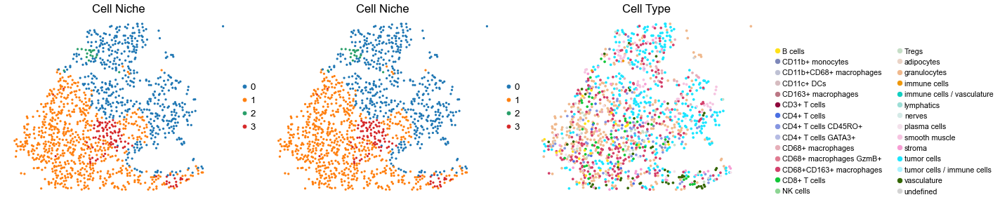

reg003_B_patient2_group2
1231


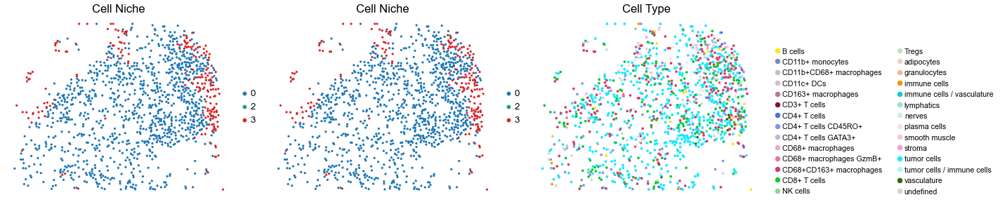

reg004_A_patient2_group2
1475


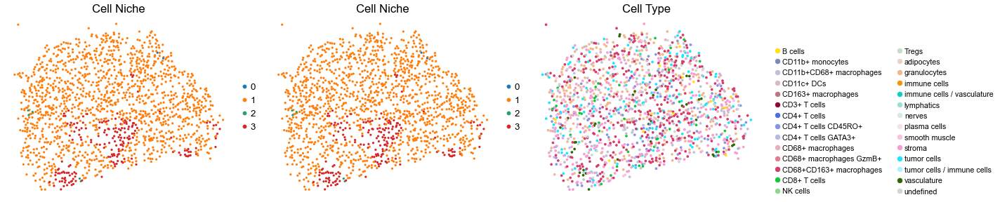

reg004_B_patient2_group2
1892


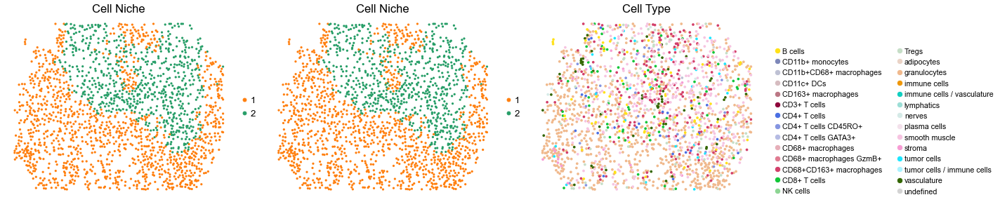

reg005_A_patient3_group2
2552


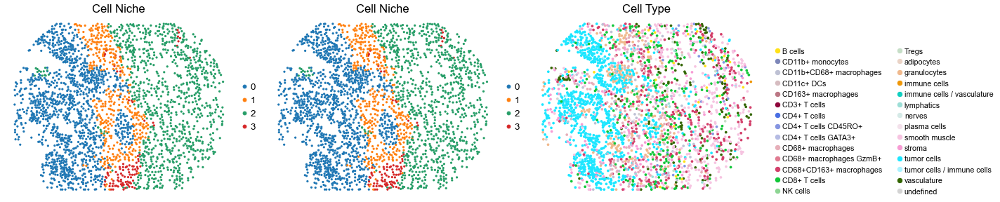

reg005_B_patient3_group2
1657


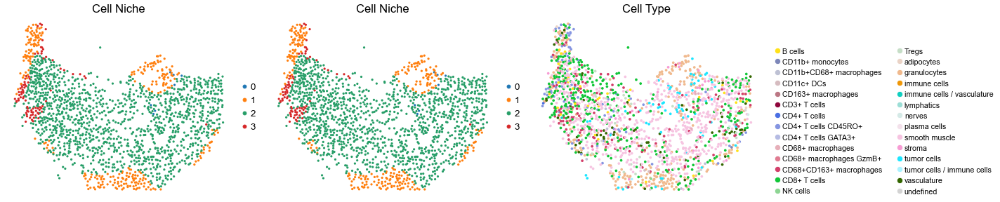

reg006_A_patient3_group2
1376


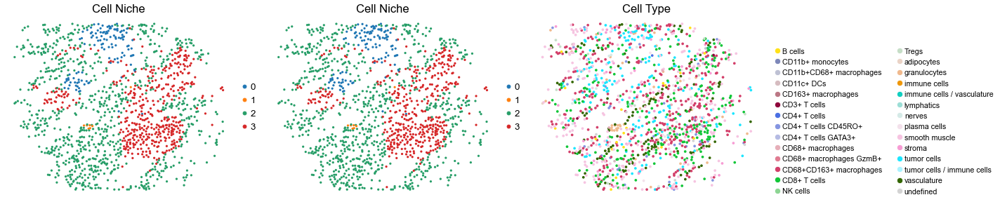

reg006_B_patient3_group2
2086


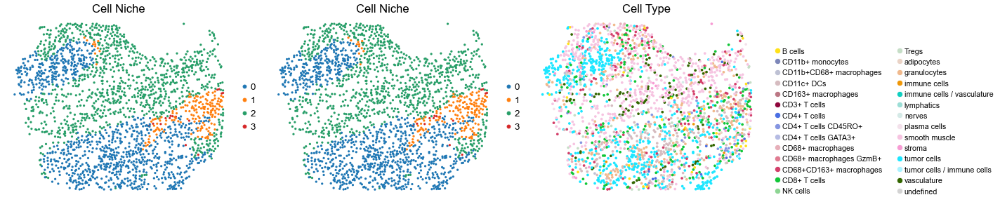

reg007_A_patient4_group2
3008


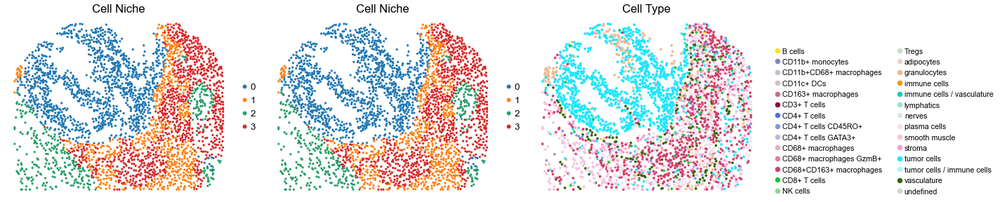

reg007_B_patient4_group2
2343


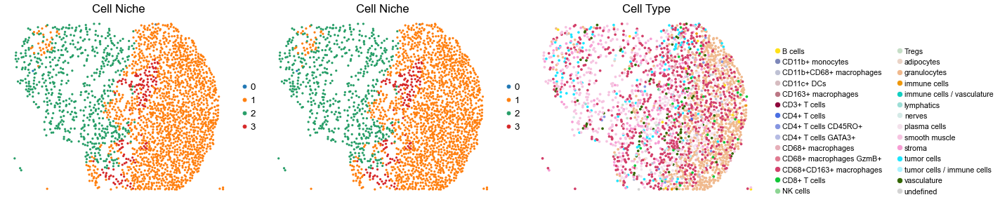

reg008_A_patient4_group2
1397


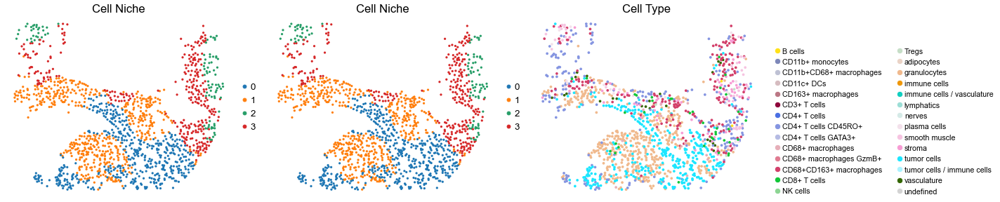

reg008_B_patient4_group2
3322


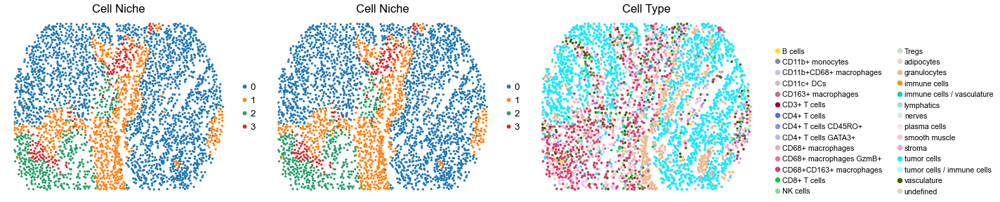

reg009_A_patient5_group2
2428


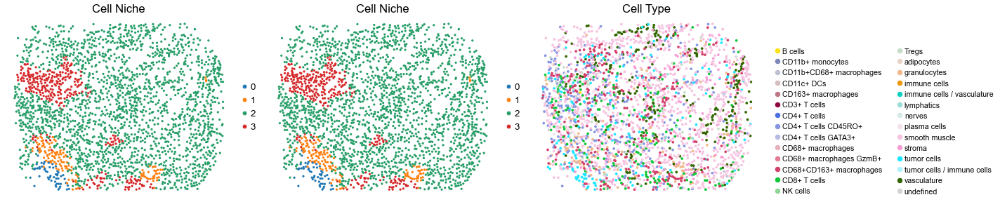

reg009_B_patient5_group2
3394


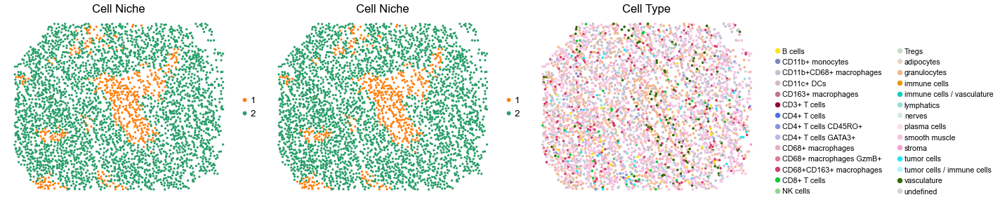

reg010_A_patient5_group2
2077


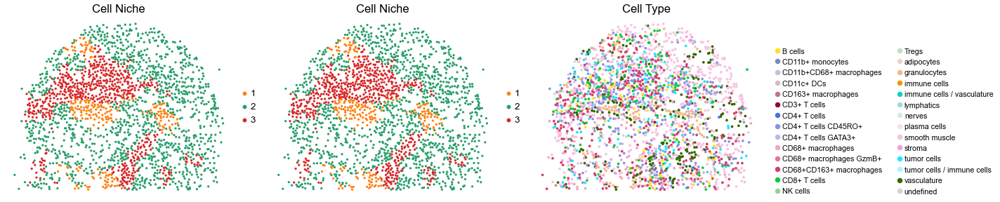

reg010_B_patient5_group2
1250


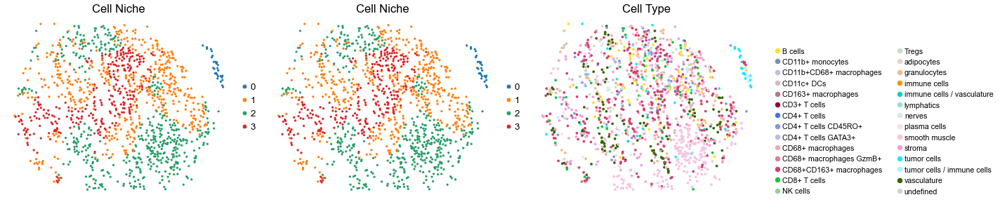

reg013_A_patient7_group2
1625


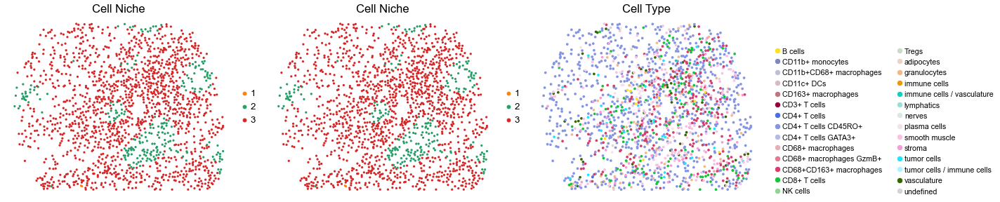

reg013_B_patient7_group2
1964


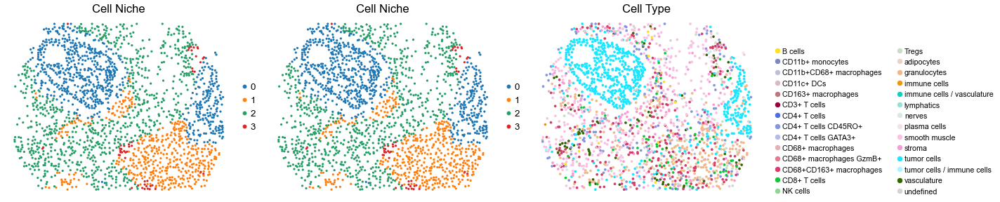

reg014_A_patient7_group2
961


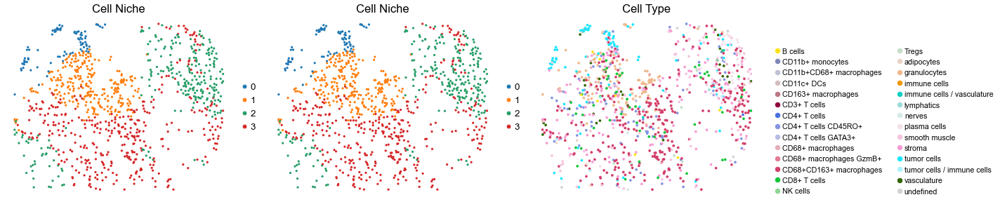

reg014_B_patient7_group2
2114


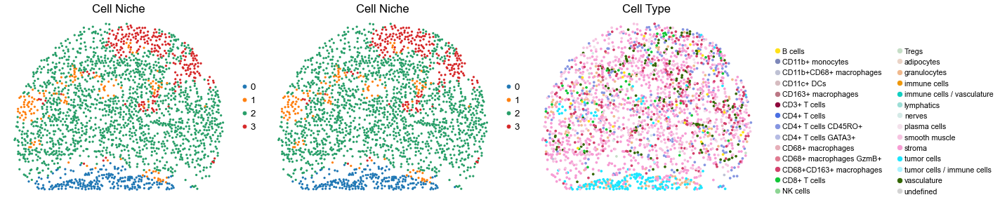

reg015_A_patient8_group2
2454


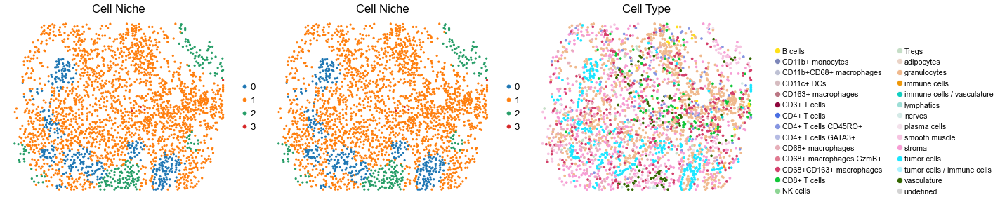

reg015_B_patient8_group2
1574


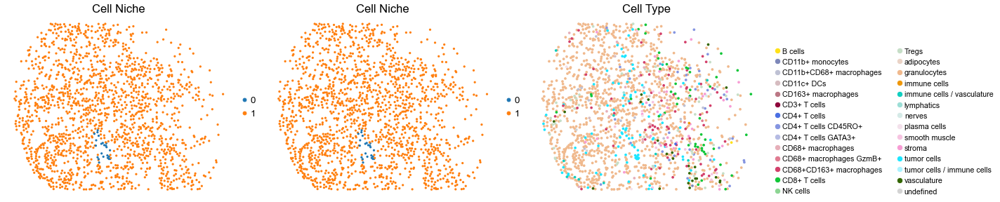

reg016_A_patient8_group2
1948


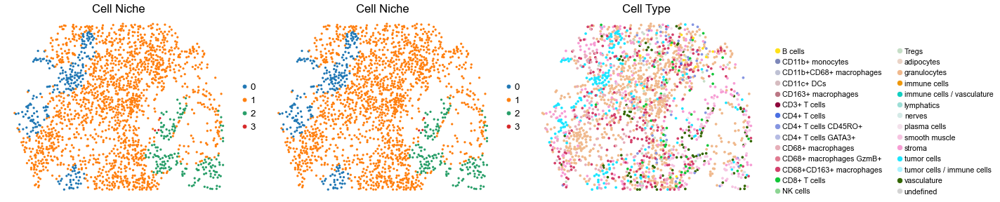

reg016_B_patient8_group2
2396


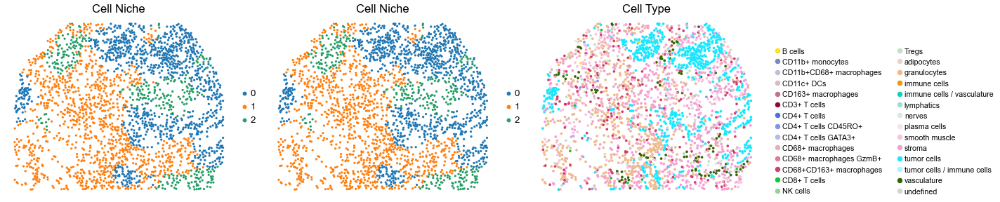

reg017_A_patient9_group2
2666


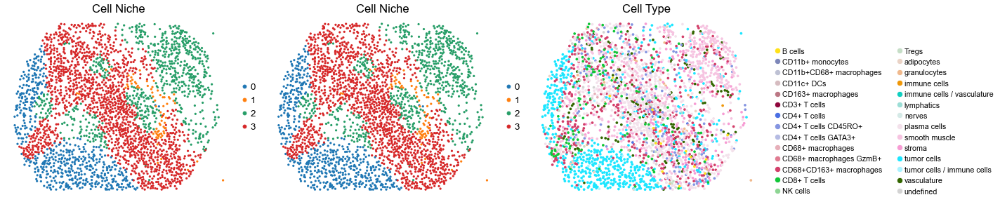

reg017_B_patient9_group2
2784


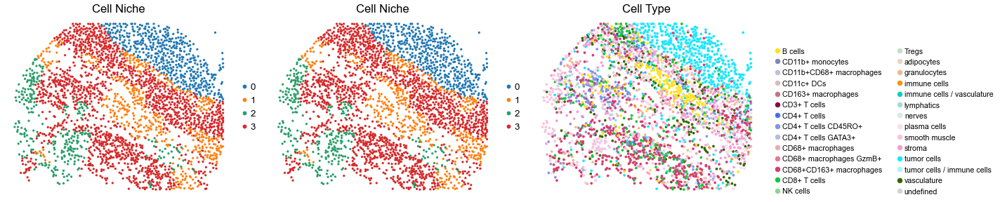

reg018_A_patient9_group2
2029


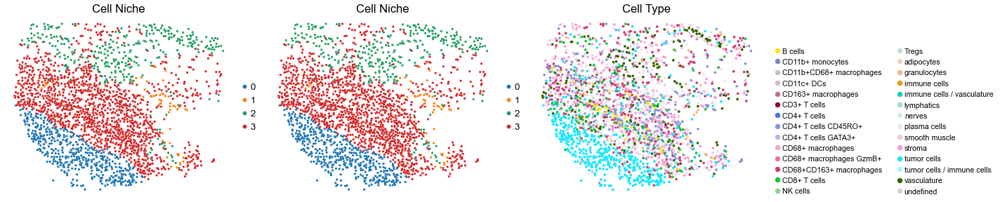

reg018_B_patient9_group2
2504


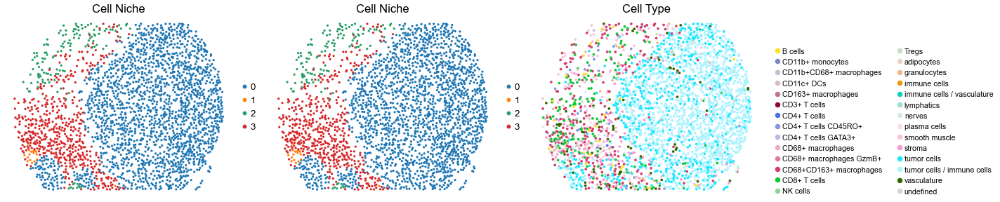

reg027_A_patient14_group2
2389


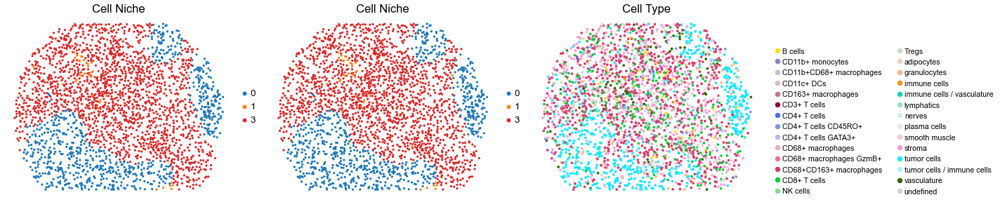

reg027_B_patient14_group2
1956


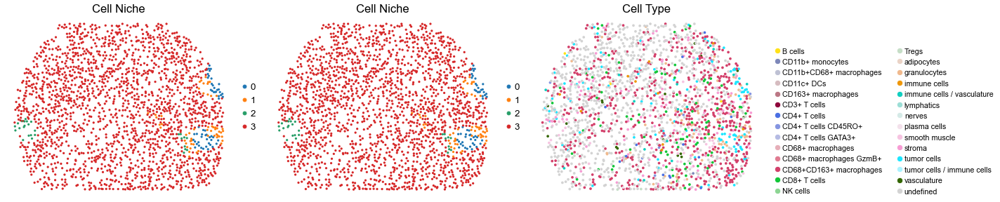

reg028_A_patient14_group2
2291


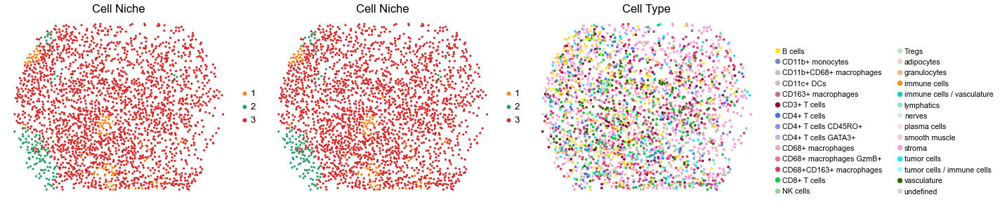

reg028_B_patient14_group2
2201


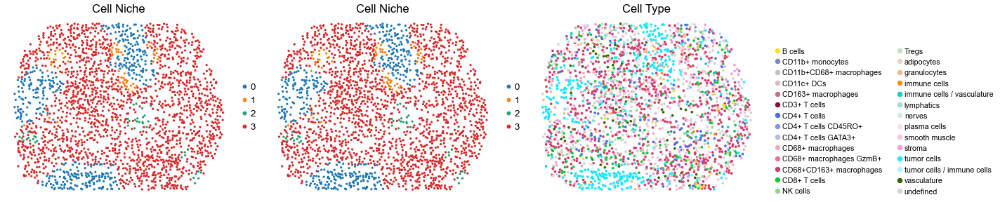

reg029_A_patient15_group2
2670


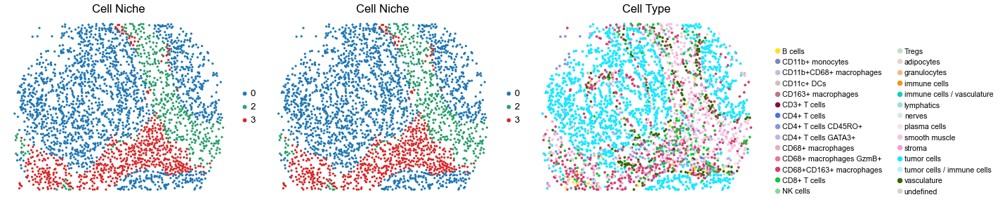

reg029_B_patient15_group2
2020


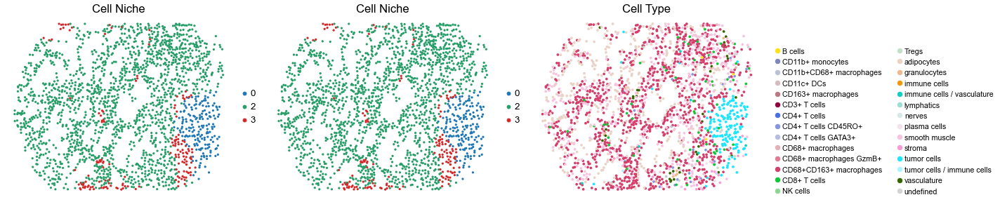

reg030_A_patient15_group2
2268


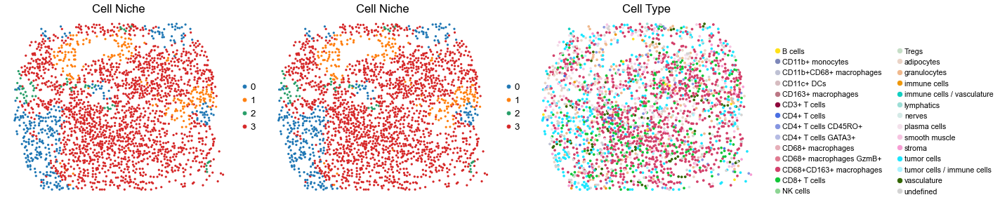

reg030_B_patient15_group2
2093


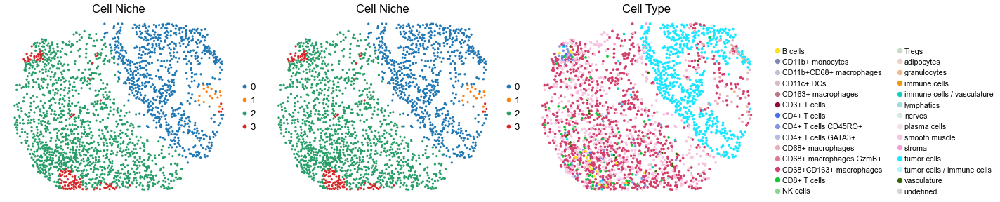

reg031_A_patient16_group2
2560


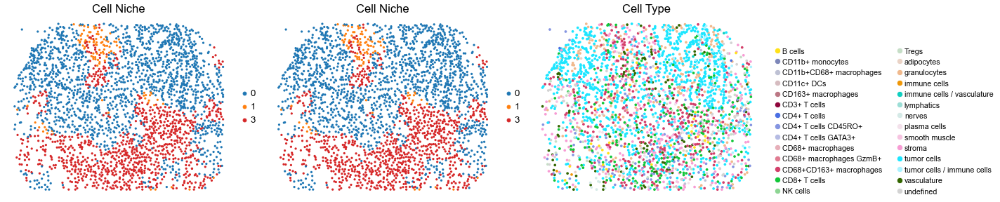

reg031_B_patient16_group2
2124


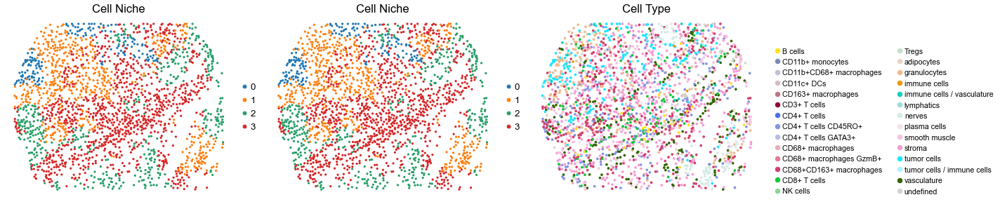

reg032_A_patient16_group2
2719


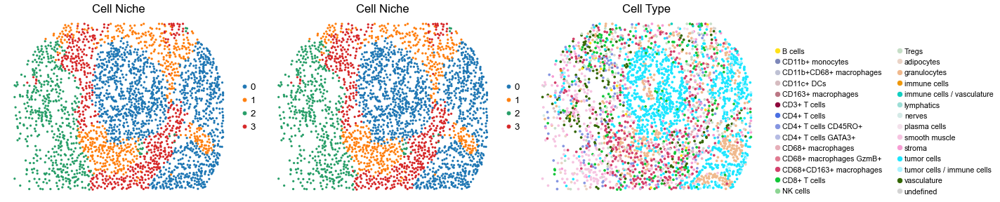

reg032_B_patient16_group2
1593


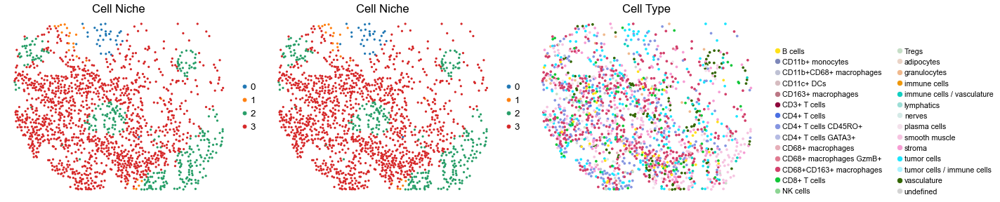

reg035_A_patient18_group2
2726


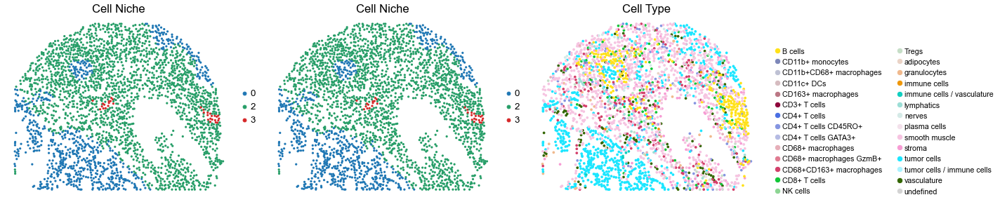

reg035_B_patient18_group2
2247


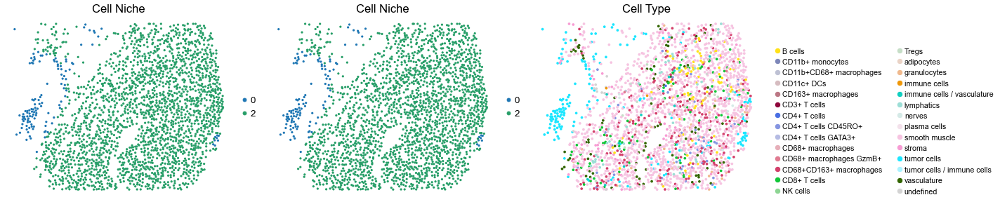

reg036_A_patient18_group2
3338


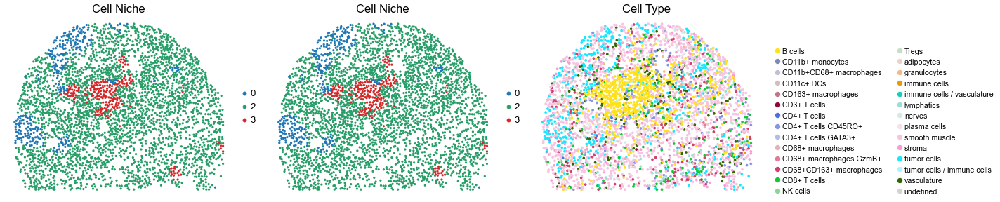

reg036_B_patient18_group2
3253


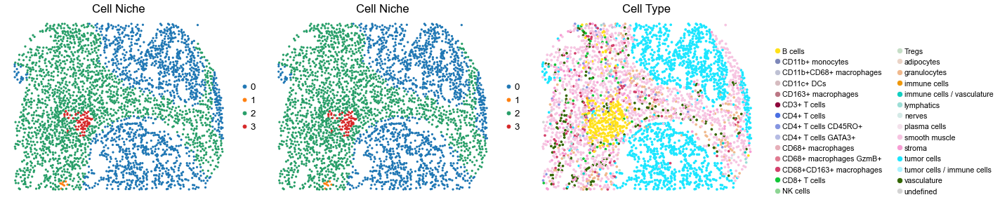

reg043_A_patient22_group2
1874


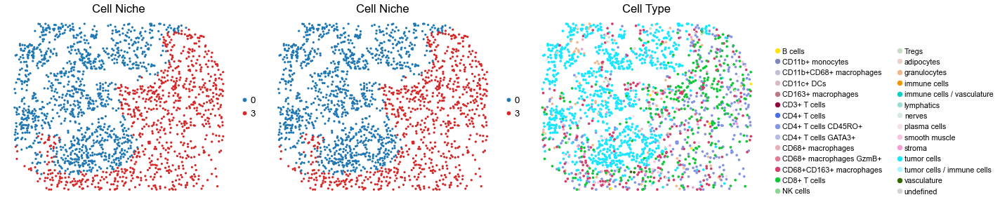

reg043_B_patient22_group2
582


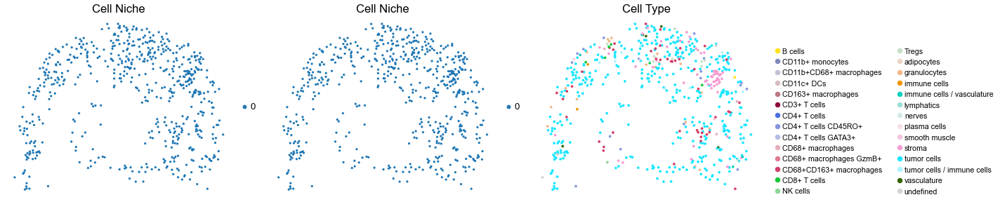

reg044_A_patient22_group2
1019


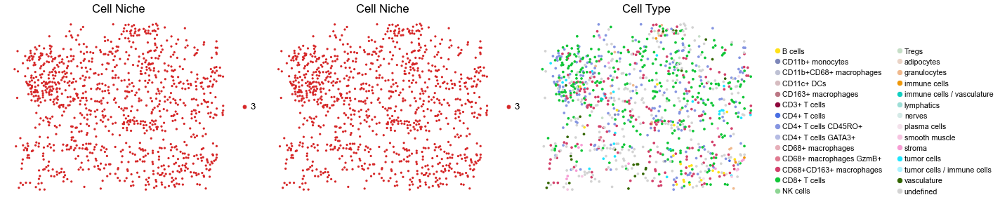

reg044_B_patient22_group2
433


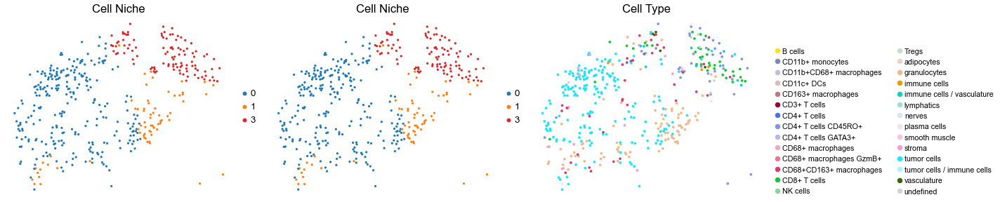

reg045_A_patient23_group2
2668


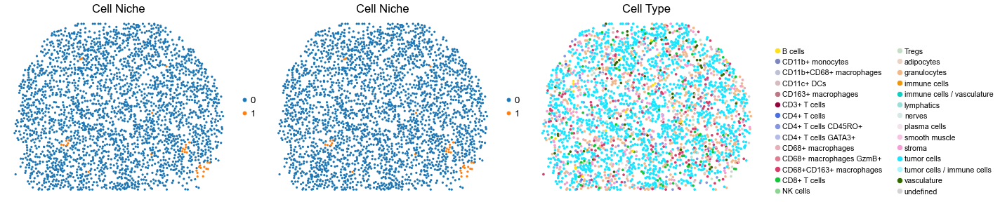

reg045_B_patient23_group2
978


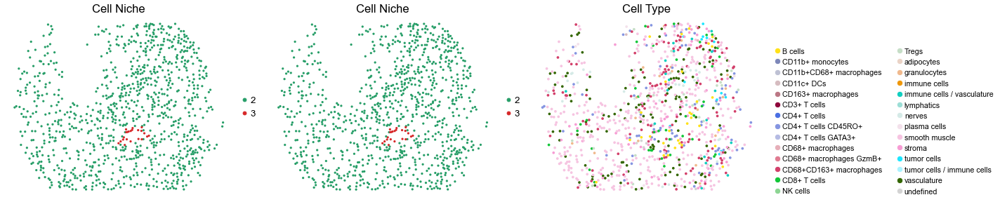

reg046_A_patient23_group2
2133


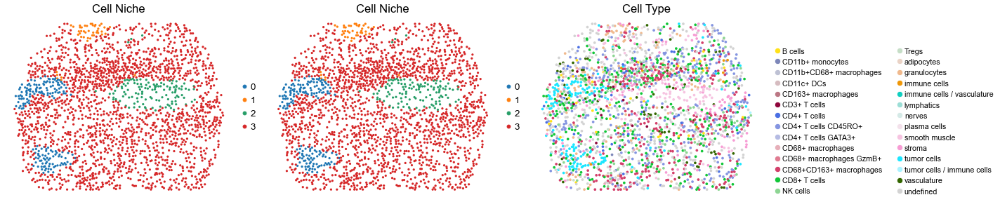

reg046_B_patient23_group2
2307


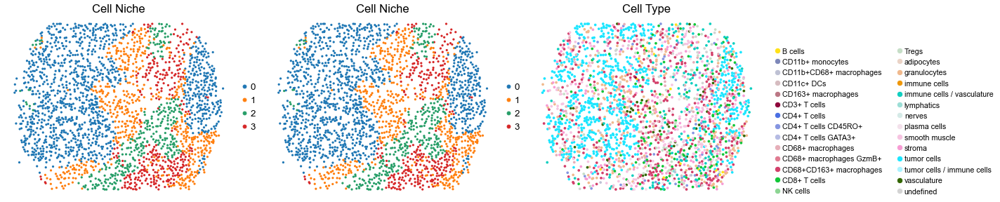

reg049_A_patient25_group2
2429


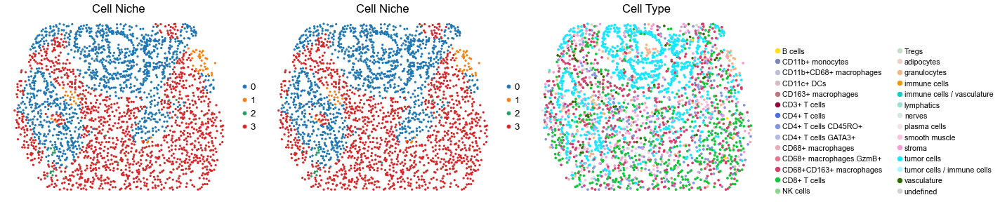

reg049_B_patient25_group2
1252


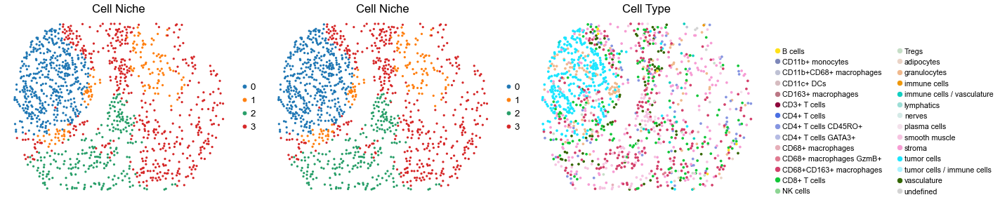

reg050_A_patient25_group2
1072


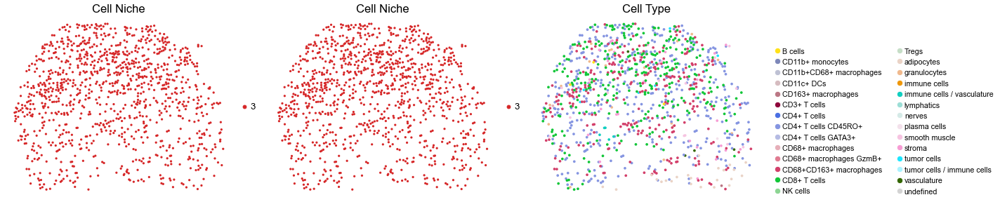

reg050_B_patient25_group2
1603


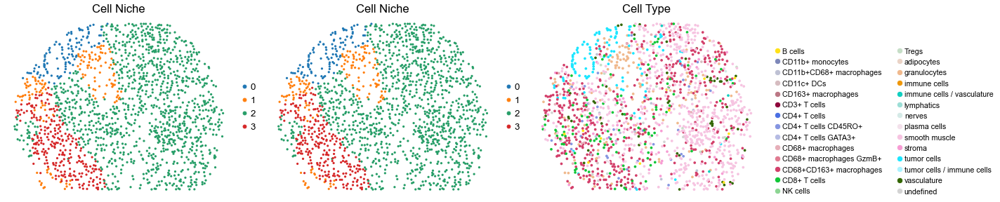

reg051_A_patient26_group2
1615


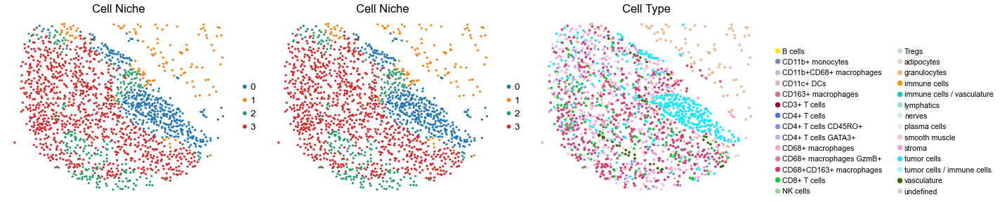

reg051_B_patient26_group2
1780


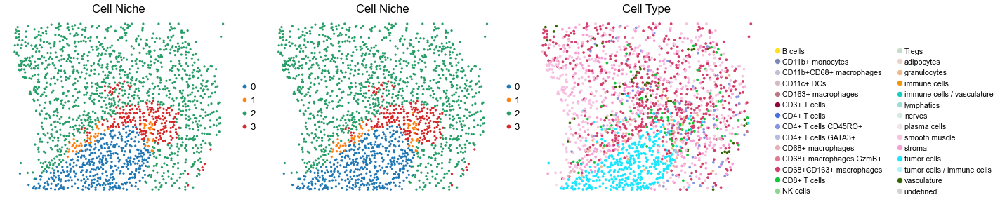

reg052_A_patient26_group2
1930


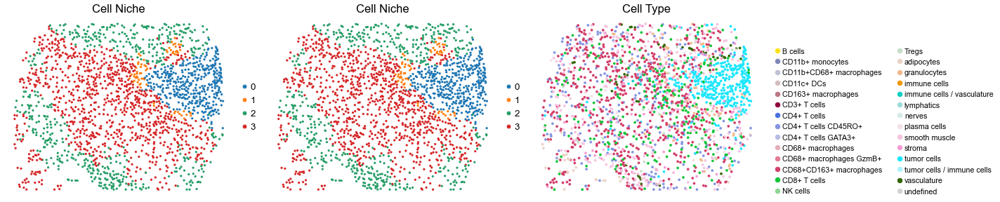

reg052_B_patient26_group2
2177


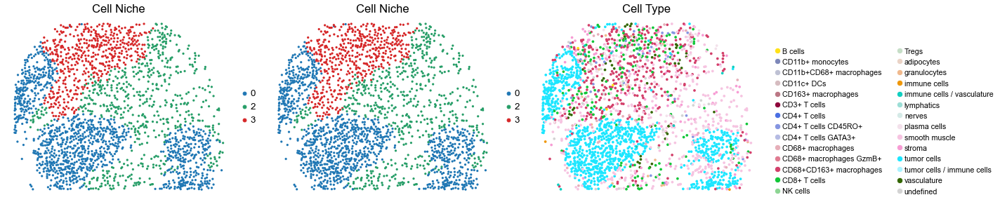

reg053_A_patient27_group2
1998


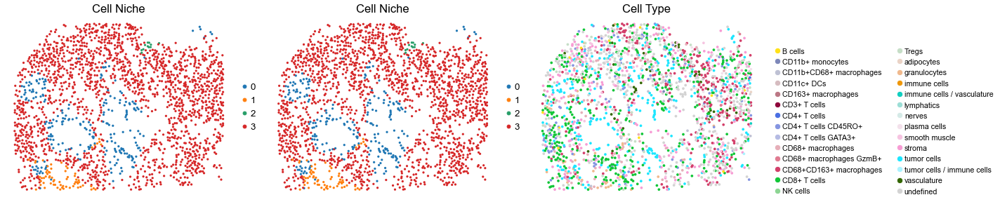

reg053_B_patient27_group2
146


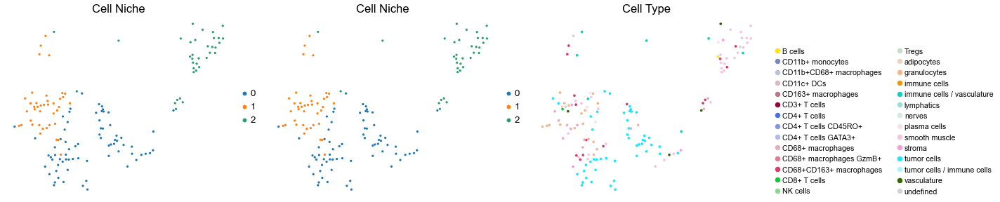

reg054_A_patient27_group2
1603


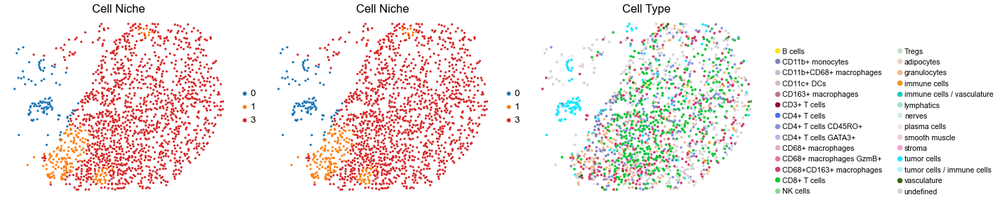

reg054_B_patient27_group2
302


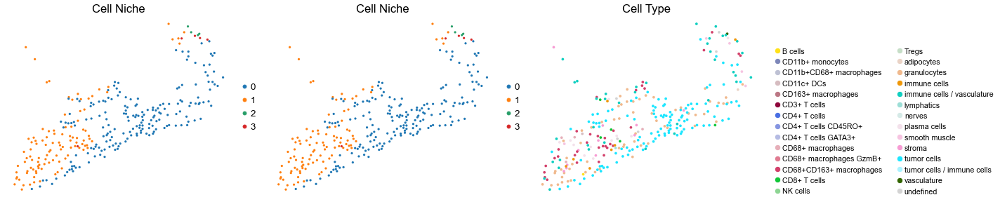

reg059_A_patient30_group2
2877


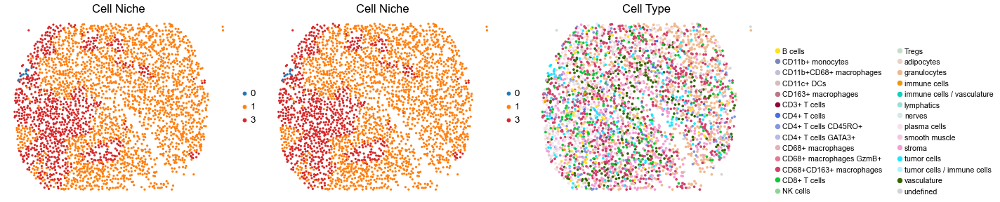

reg059_B_patient30_group2
1815


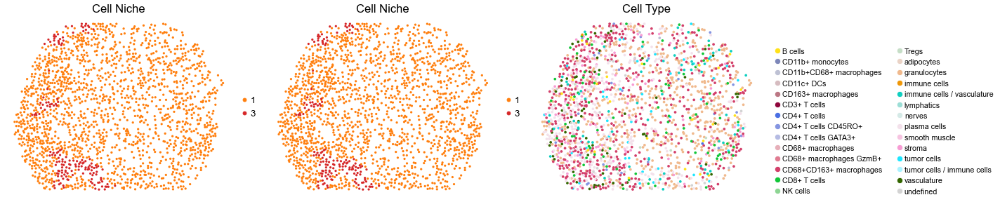

reg060_A_patient30_group2
2396


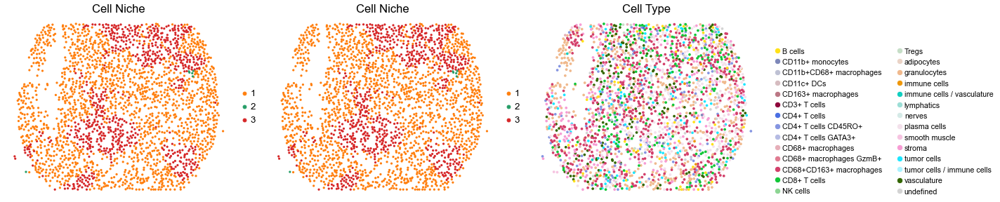

reg060_B_patient30_group2
2295


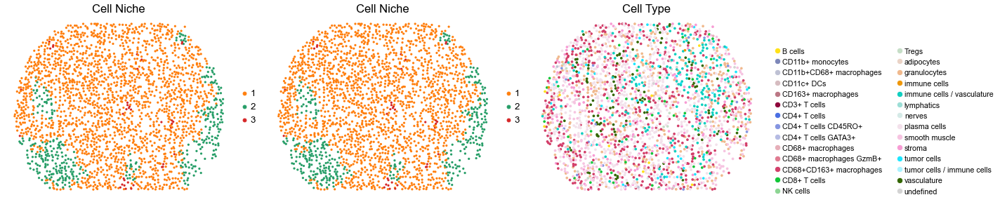

reg061_A_patient31_group2
1917


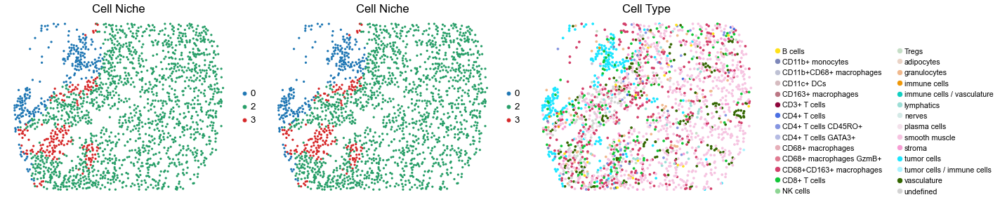

reg061_B_patient31_group2
1780


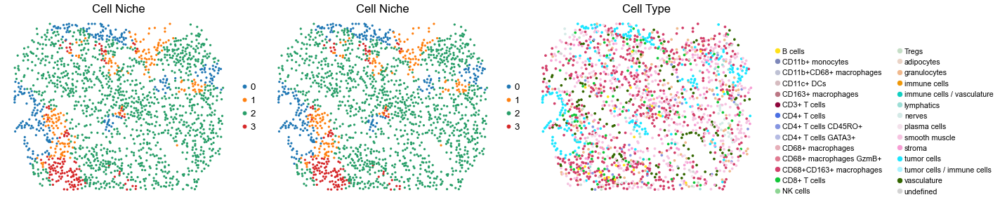

reg062_A_patient31_group2
2478


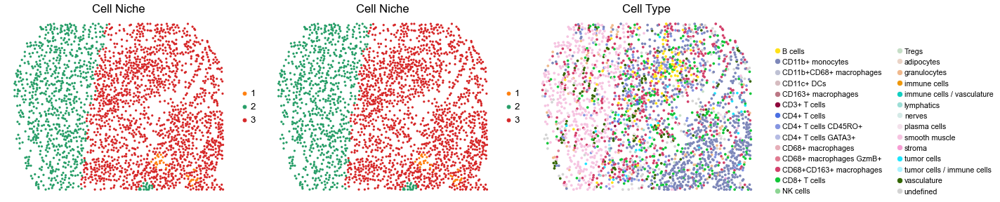

reg062_B_patient31_group2
1384


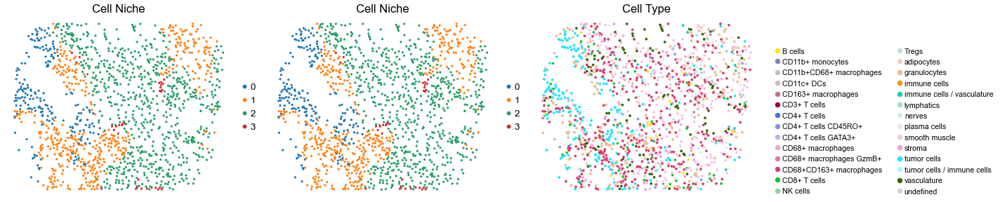

In [ ]:
for i in range(len(slice_name_list)):
    
    print(slice_name_list[i])
    adata = adata_concat_new[adata_concat_new.obs['slice_name'] == slice_name_list[i], :].copy()
    print(adata.shape[0])

    fig, axes = plt.subplots(1, 3, figsize=(24, 5))

    sc.pl.embedding(adata, basis='spatial', color='niche_label', palette=niche_color_dict,
                    ax=axes[0], s=60, show=False, frameon=False, title='Cell Niche', legend_fontsize=16)
    axes[0].set_title('Cell Niche', fontsize=20)

    sc.pl.embedding(adata, basis='spatial', color='niche_label', palette=niche_color_dict,
                    ax=axes[1], s=60, show=False, frameon=False, title='Cell Niche', legend_fontsize=16)
    axes[1].set_title('Cell Niche', fontsize=20)

    sc.pl.embedding(adata, basis='spatial', color='ClusterName', palette=ct_color_dict,
                    ax=axes[2], s=80, show=False, frameon=False, title='Cell Type', legend_fontsize=16)
    axes[2].set_title('Cell Type', fontsize=20)
    
    ct_legend_elements = [
        Line2D([0], [0], marker='o', color='w', label=label,
            markerfacecolor=color, markersize=10)
        for label, color in ct_color_dict.items()
    ]
    axes[2].legend(handles=ct_legend_elements, loc=(1.05, 0), frameon=False, ncol=2)
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()

#### Case group

reg001_A_patient1_group1
1107


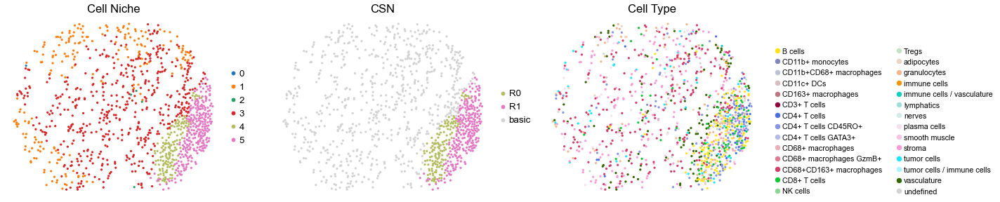

reg001_B_patient1_group1
349


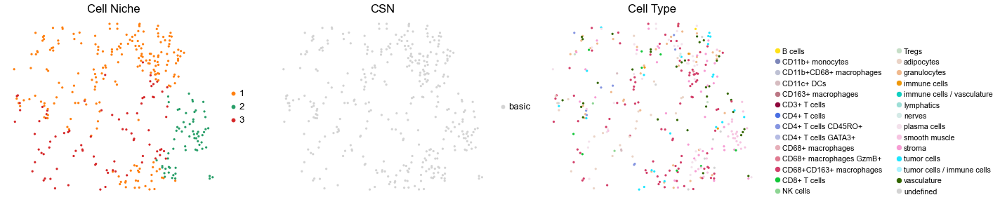

reg002_A_patient1_group1
1373


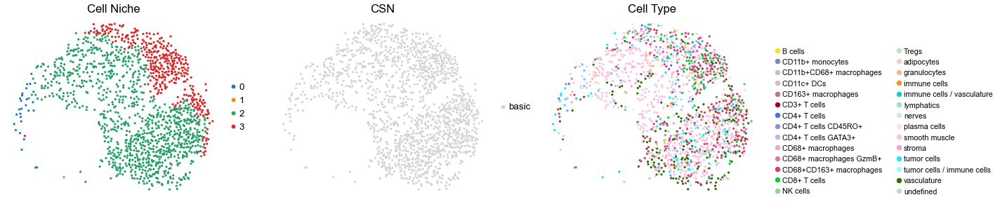

reg002_B_patient1_group1
2623


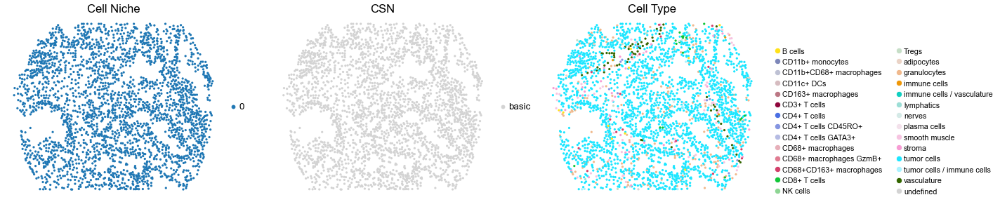

reg011_A_patient6_group1
2746


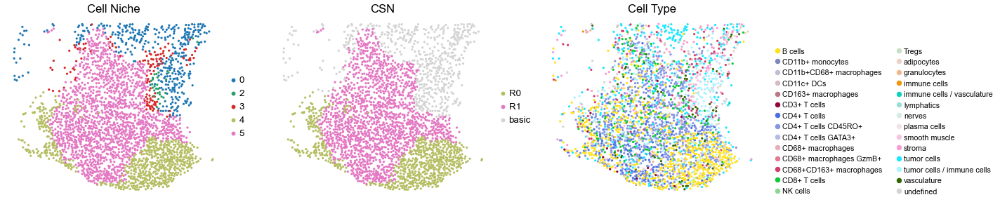

reg011_B_patient6_group1
917


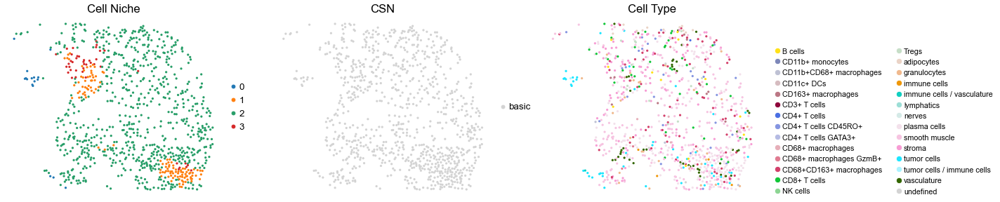

reg012_A_patient6_group1
1762


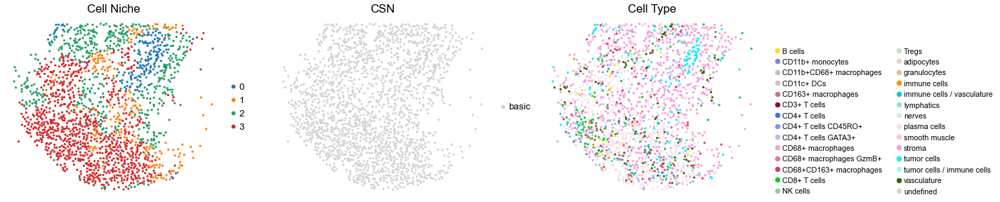

reg012_B_patient6_group1
475


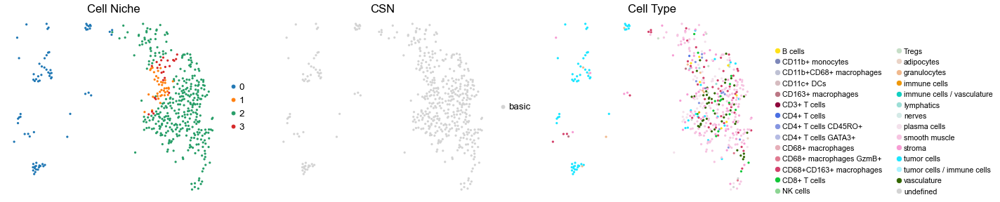

reg019_A_patient10_group1
1555


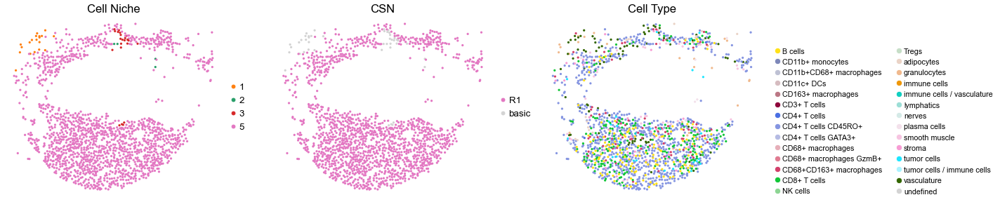

reg019_B_patient10_group1
107


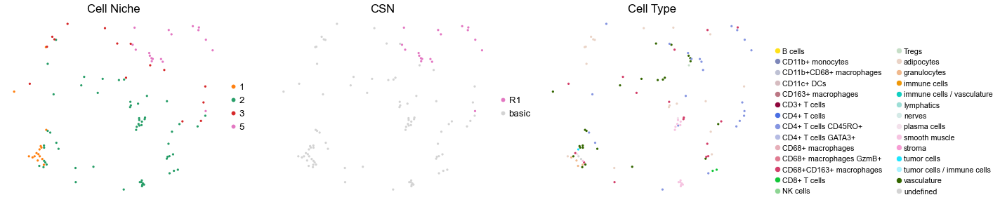

reg020_A_patient10_group1
2136


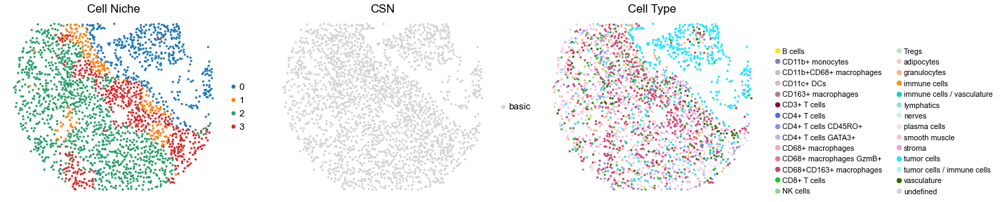

reg020_B_patient10_group1
2668


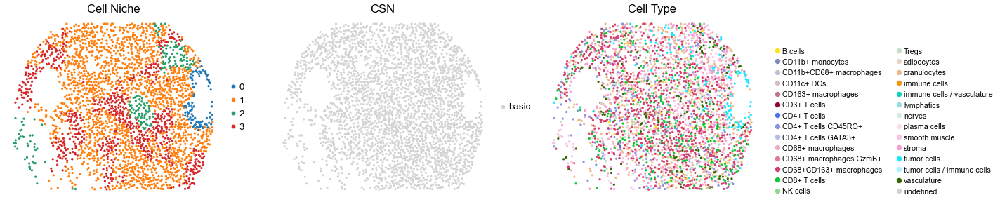

reg021_A_patient11_group1
2663


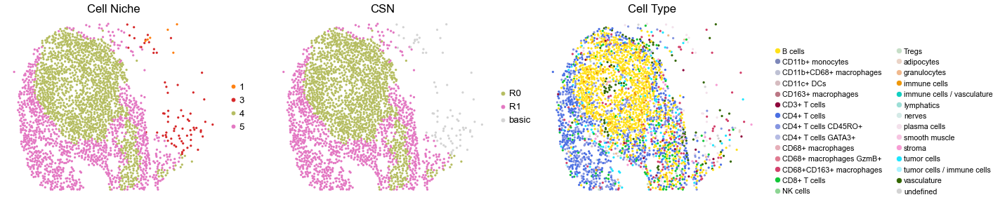

reg021_B_patient11_group1
332


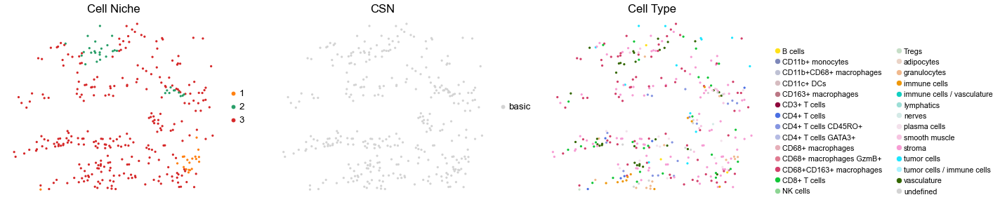

reg022_A_patient11_group1
2125


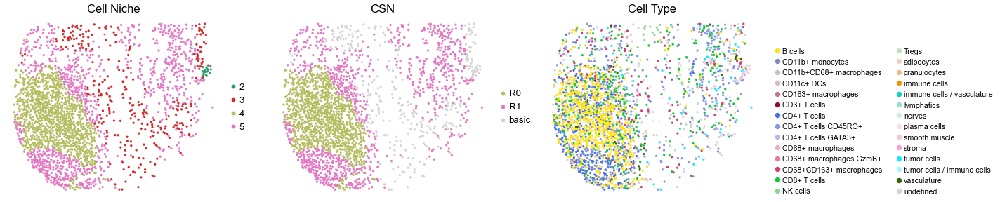

reg022_B_patient11_group1
690


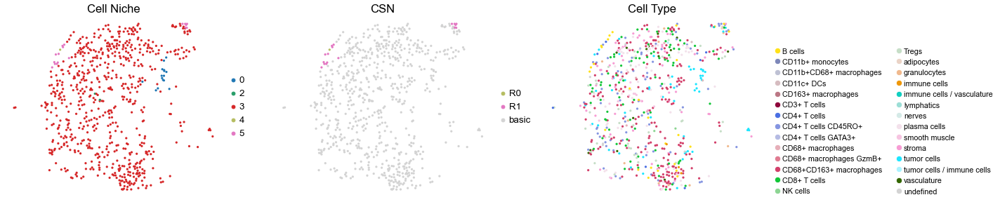

reg023_B_patient12_group1
2372


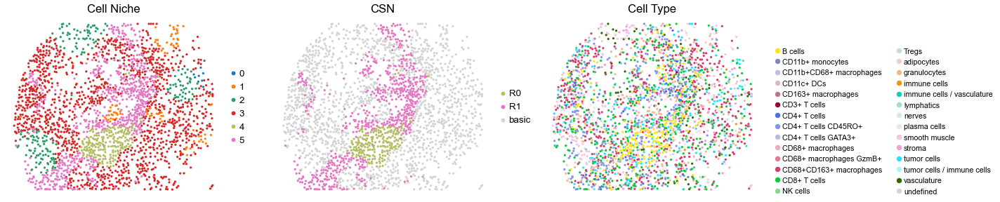

reg024_A_patient12_group1
1095


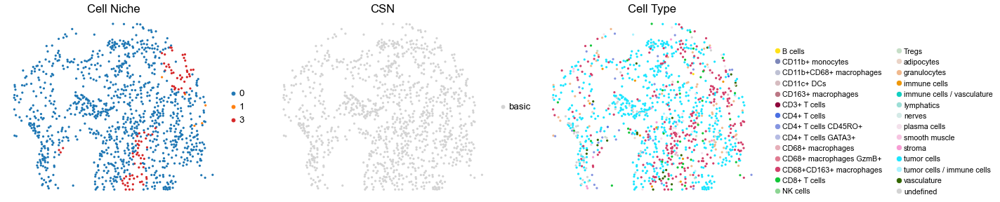

reg024_B_patient12_group1
2373


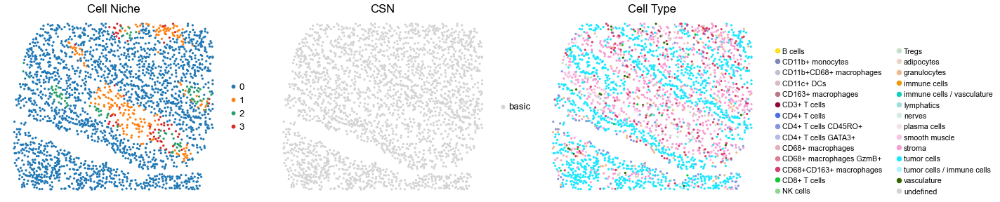

reg025_A_patient13_group1
1345


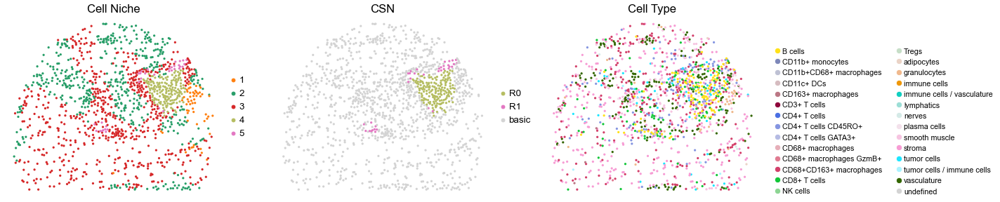

reg025_B_patient13_group1
1968


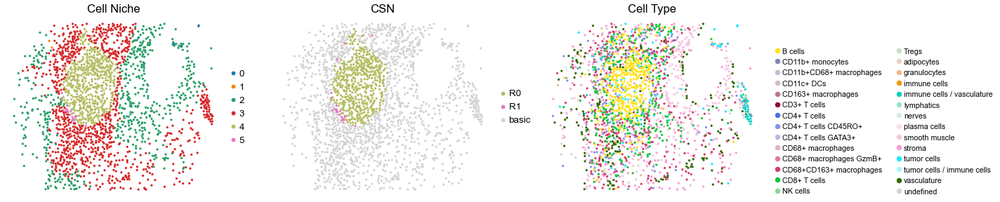

reg026_A_patient13_group1
2331


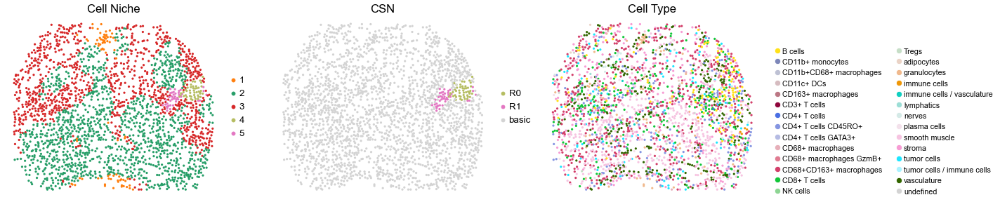

reg026_B_patient13_group1
2734


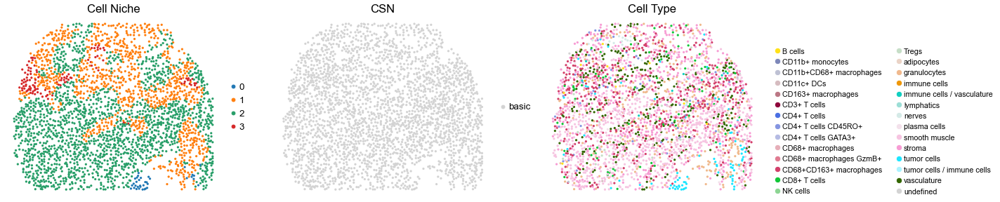

reg033_A_patient17_group1
2797


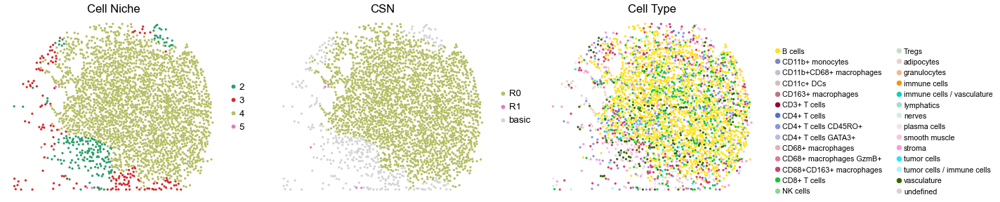

reg033_B_patient17_group1
3429


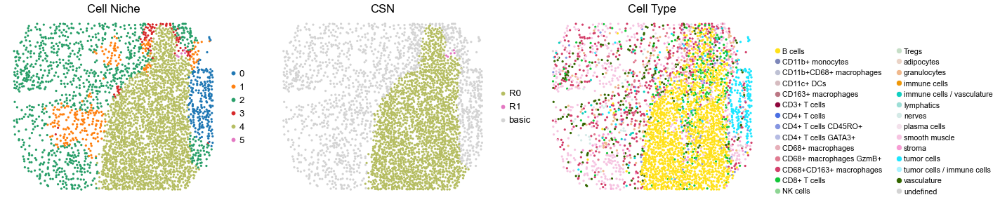

reg034_A_patient17_group1
2153


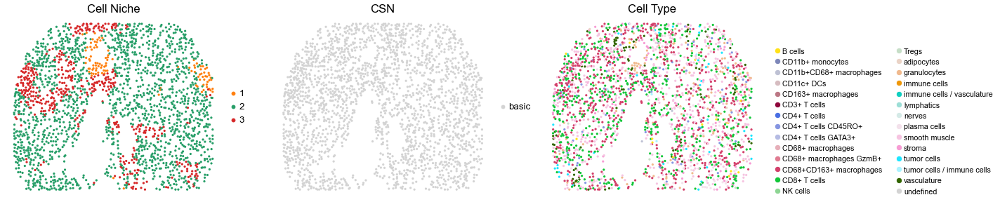

reg034_B_patient17_group1
2104


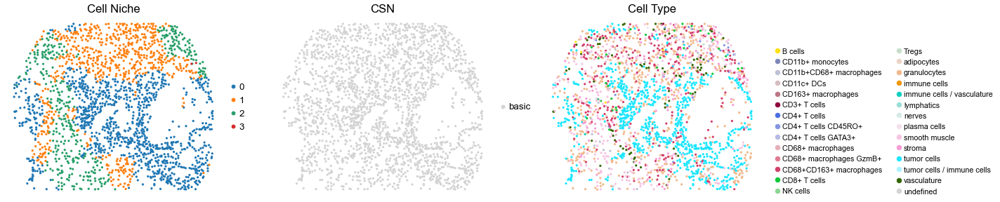

reg037_A_patient19_group1
1539


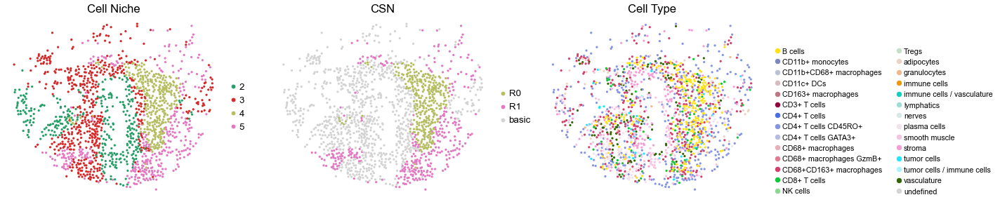

reg037_B_patient19_group1
402


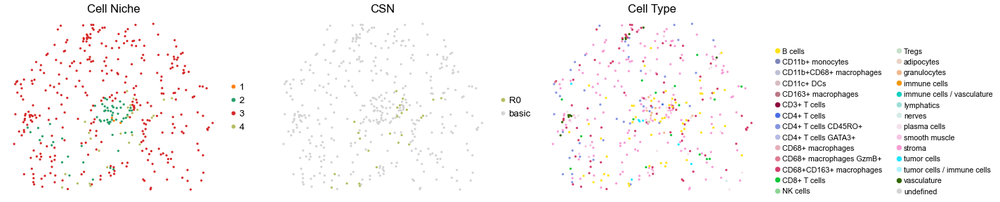

reg038_A_patient19_group1
2622


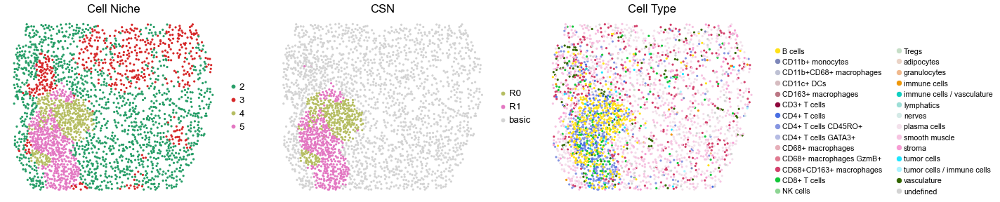

reg038_B_patient19_group1
1663


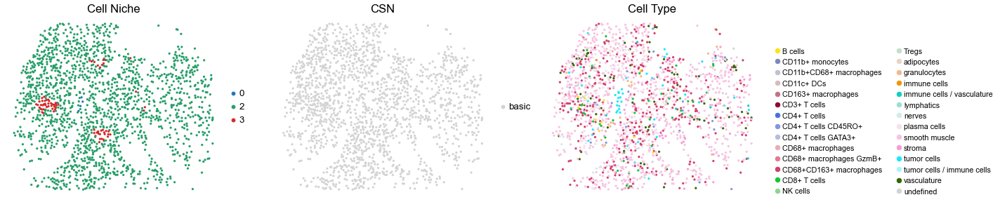

reg039_A_patient20_group1
2421


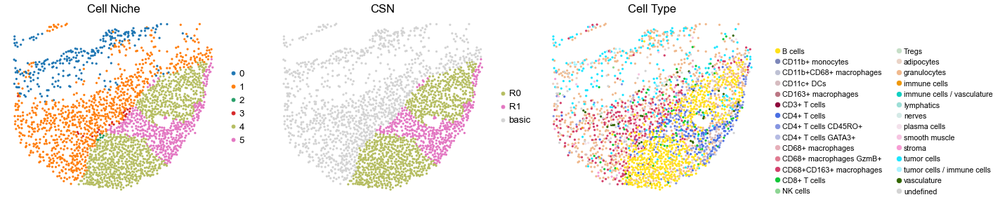

reg039_B_patient20_group1
767


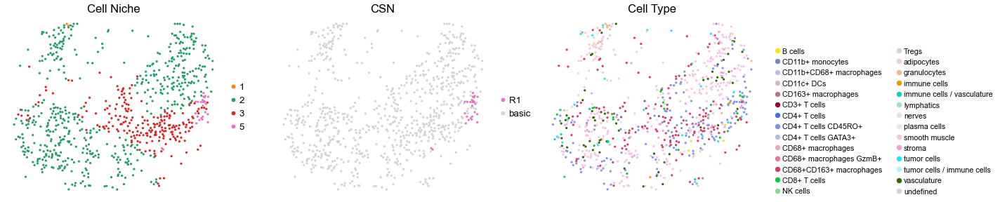

reg040_A_patient20_group1
2134


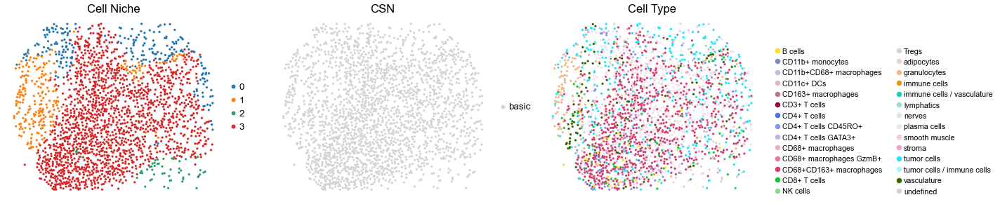

reg040_B_patient20_group1
851


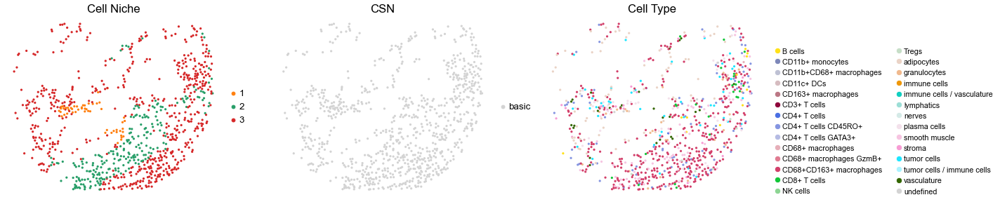

reg041_A_patient21_group1
2166


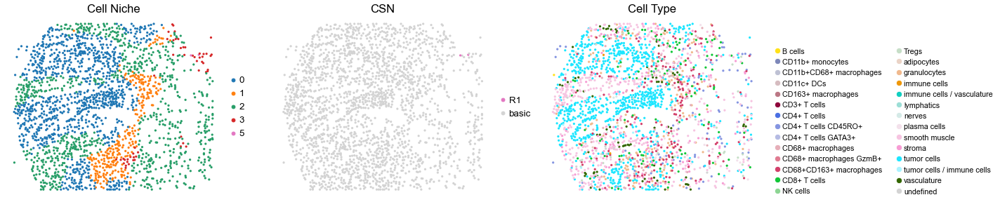

reg041_B_patient21_group1
2233


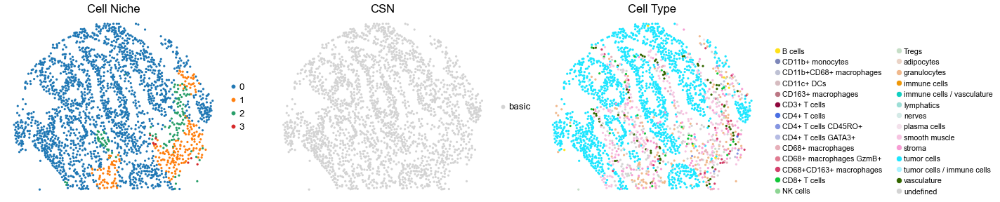

reg042_A_patient21_group1
2564


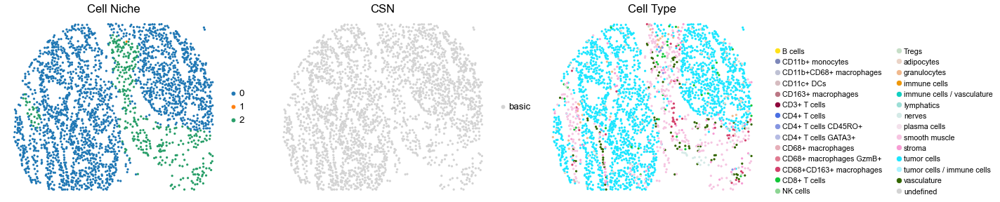

reg042_B_patient21_group1
2077


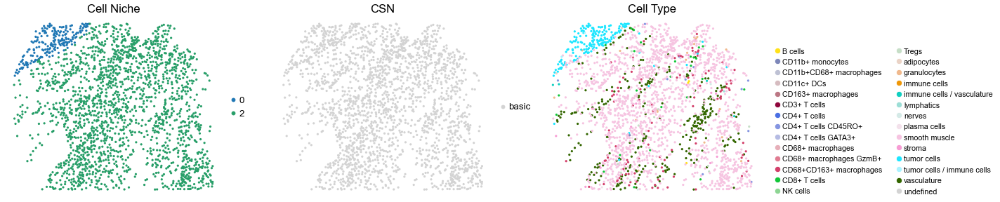

reg047_A_patient24_group1
1838


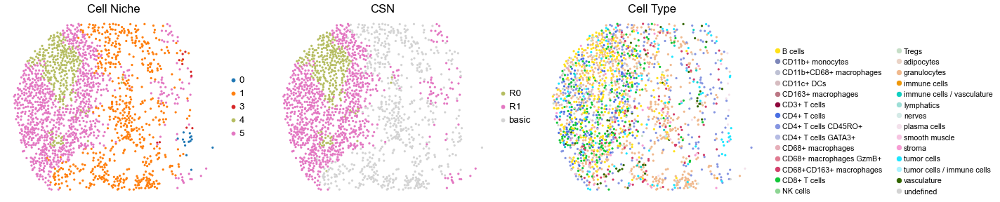

reg047_B_patient24_group1
962


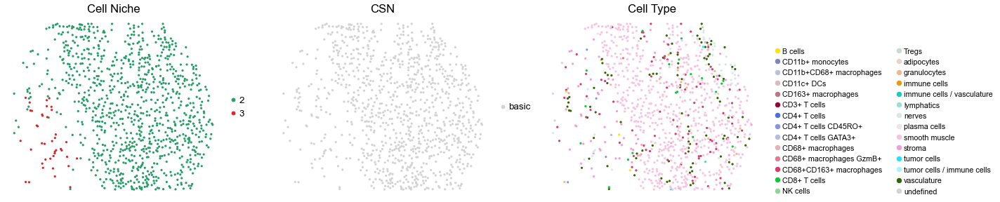

reg048_A_patient24_group1
1794


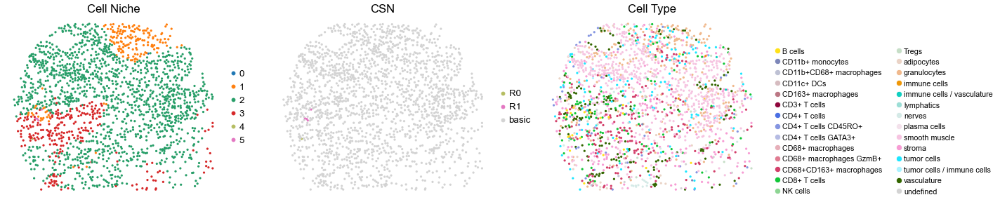

reg048_B_patient24_group1
1590


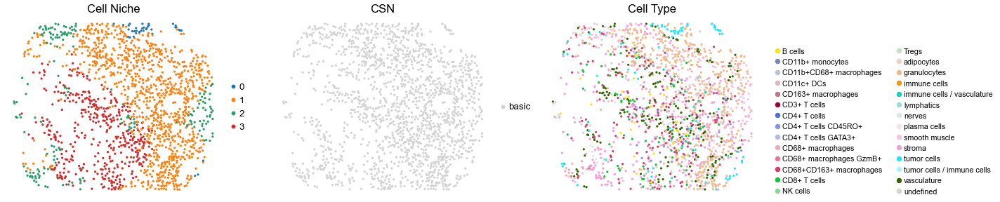

reg055_A_patient28_group1
3796


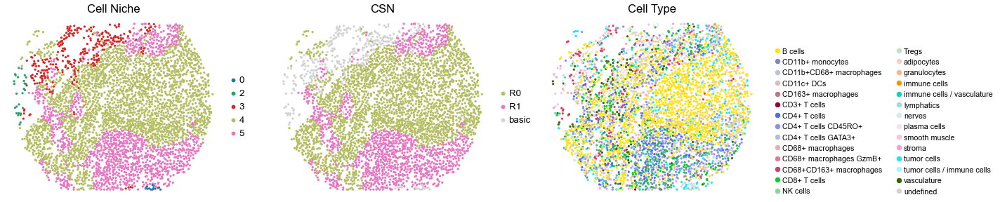

reg055_B_patient28_group1
135


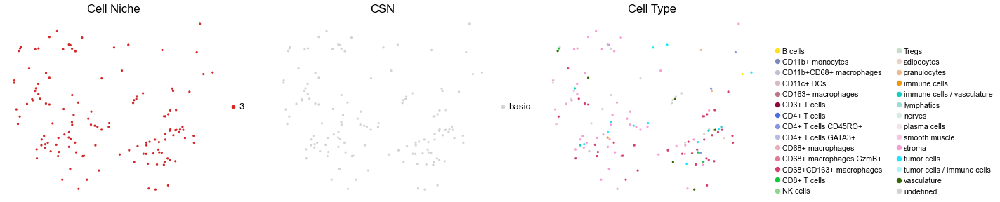

reg056_A_patient28_group1
815


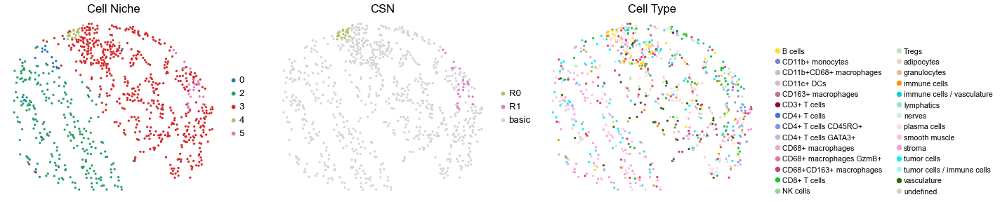

reg056_B_patient28_group1
1394


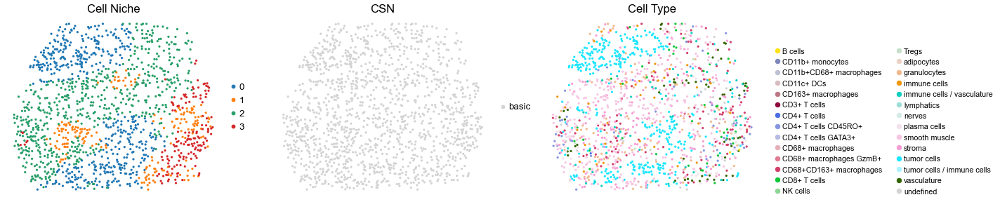

reg057_A_patient29_group1
80


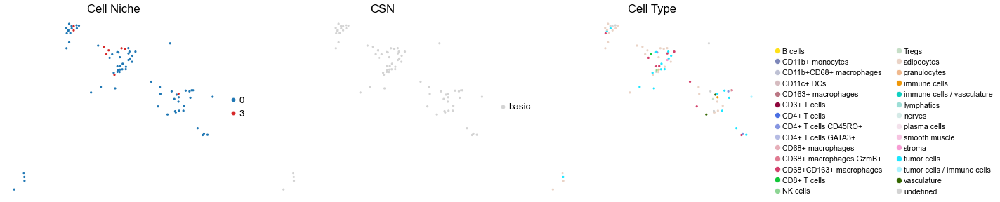

reg057_B_patient29_group1
1052


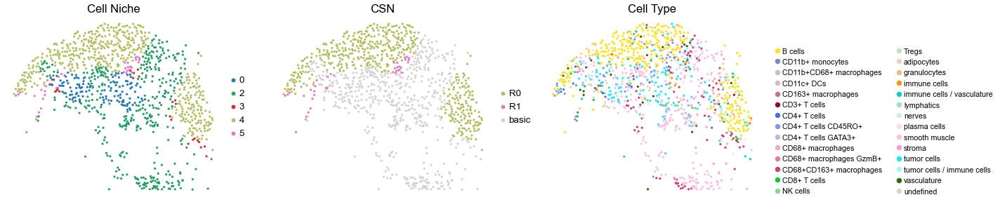

reg058_A_patient29_group1
2239


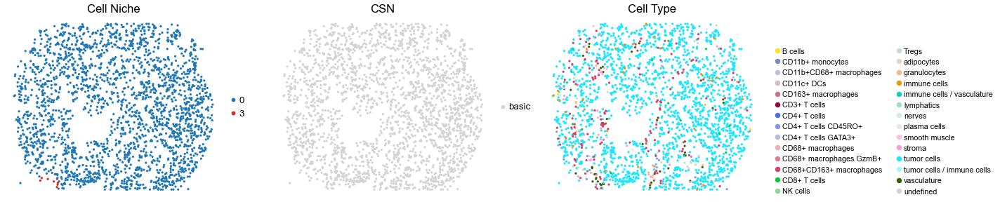

reg058_B_patient29_group1
1630


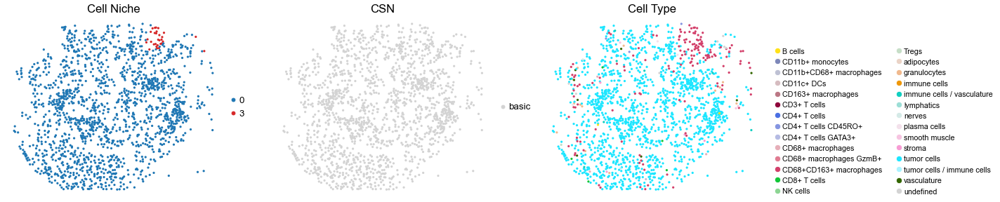

reg063_A_patient32_group1
890


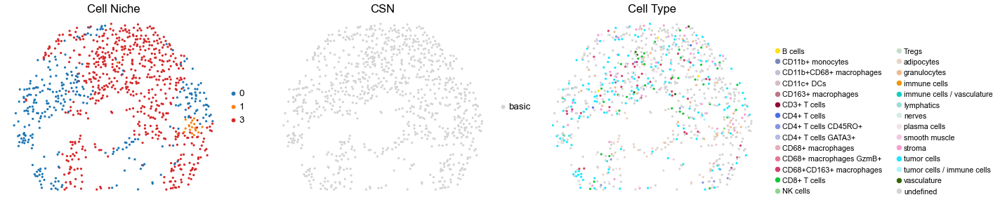

reg063_B_patient32_group1
891


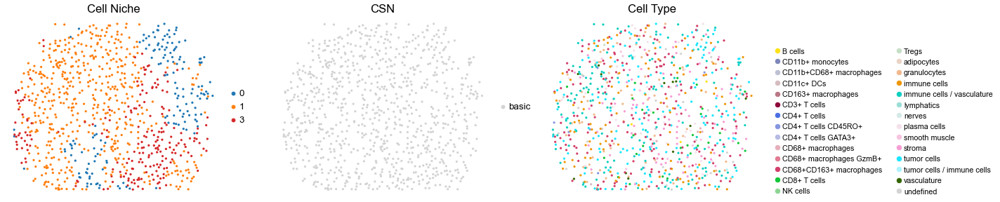

reg064_B_patient32_group1
1969


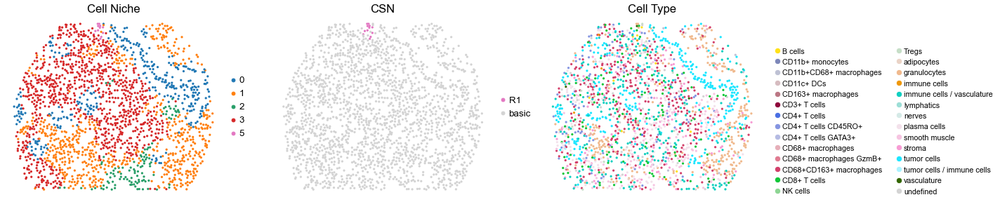

reg065_A_patient33_group1
2283


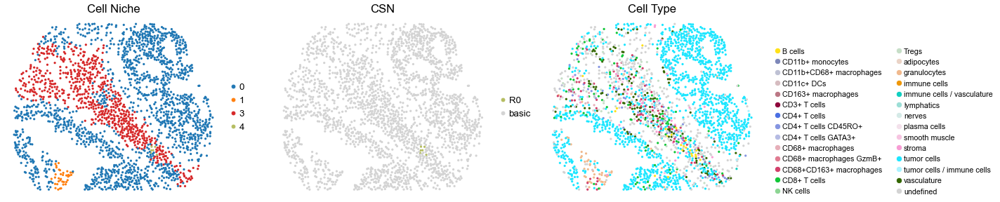

reg065_B_patient33_group1
420


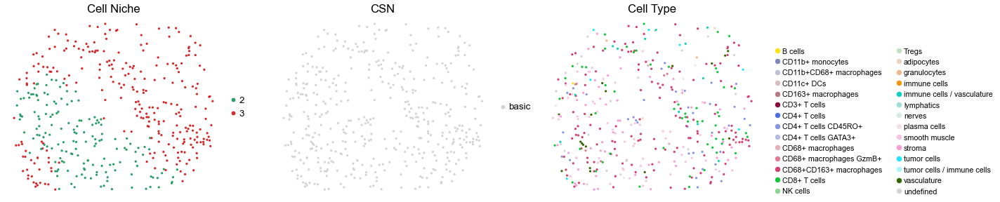

reg066_B_patient33_group1
1041


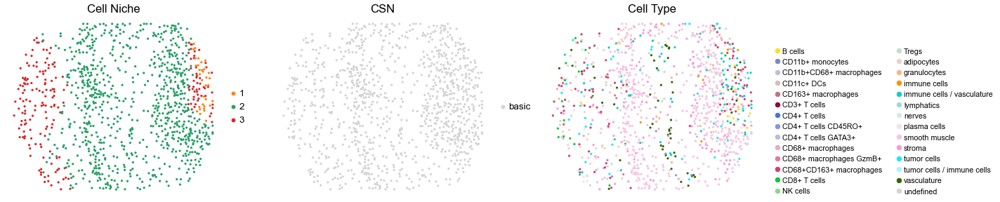

reg067_A_patient34_group1
674


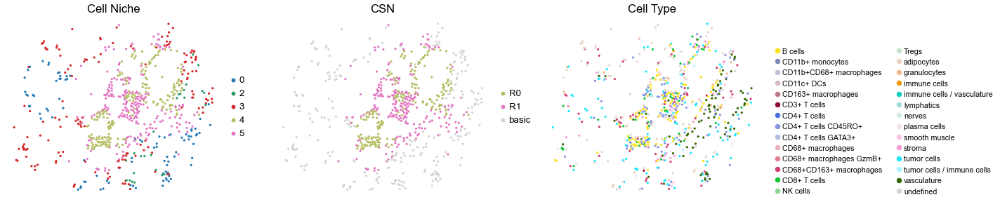

reg067_B_patient34_group1
84


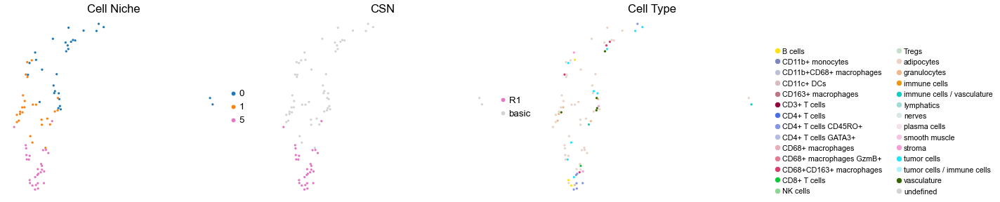

reg068_A_patient34_group1
1241


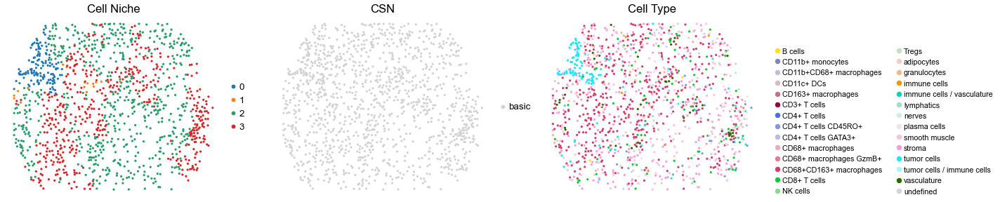

reg068_B_patient34_group1
1458


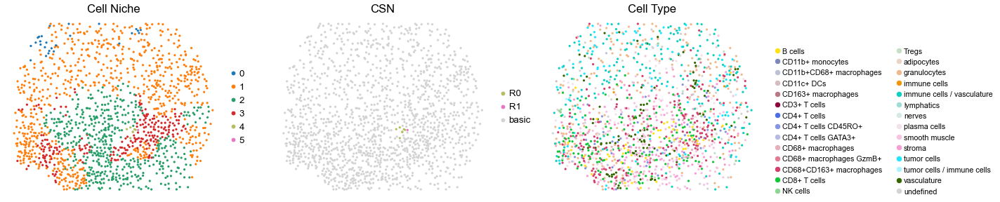

reg069_A_patient35_group1
1432


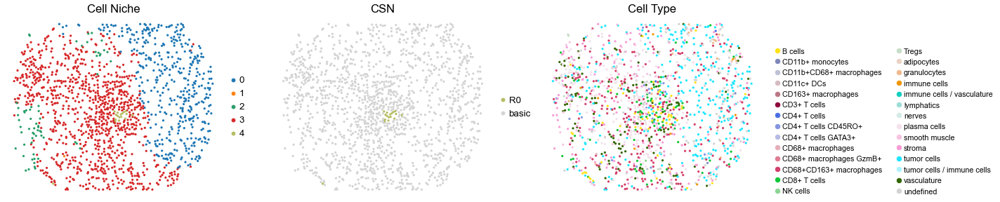

reg069_B_patient35_group1
859


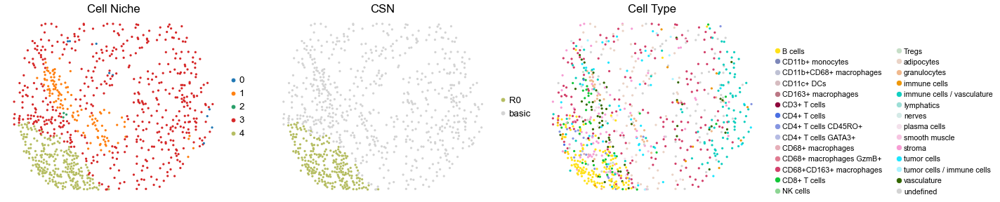

reg070_A_patient35_group1
1829


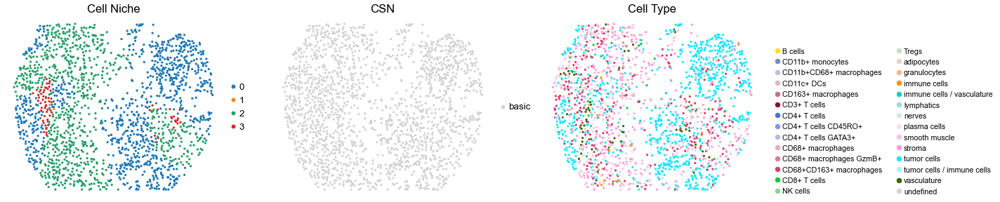

reg070_B_patient35_group1
1010


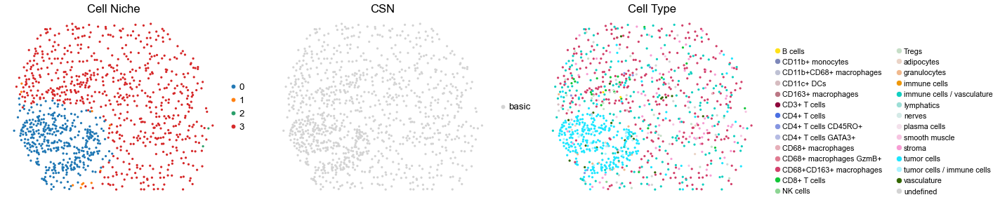

In [ ]:
for i in range(len(cond_name_list)):
    
    print(cond_name_list[i])
    adata = cond_concat_new[cond_concat_new.obs['slice_name'] == cond_name_list[i], :].copy()
    print(adata.shape[0])

    fig, axes = plt.subplots(1, 3, figsize=(24, 5))

    sc.pl.embedding(adata, basis='spatial', color='niche_label', palette=niche_color_dict,
                    ax=axes[0], s=60, show=False, frameon=False, title='Cell Niche', legend_fontsize=16)
    axes[0].set_title('Cell Niche', fontsize=20)

    sc.pl.embedding(adata, basis='spatial', color='csn_label', palette=csn_color_dict,
                    ax=axes[1], s=60, show=False, frameon=False, title='CSN', legend_fontsize=16)
    axes[1].set_title('CSN', fontsize=20)

    sc.pl.embedding(adata, basis='spatial', color='ClusterName', palette=ct_color_dict,
                    ax=axes[2], s=60, show=False, frameon=False, title='Cell Type', legend_fontsize=16)
    axes[2].set_title('Cell Type', fontsize=20)
    
    ct_legend_elements = [
        Line2D([0], [0], marker='o', color='w', label=label,
            markerfacecolor=color, markersize=10)
        for label, color in ct_color_dict.items()
    ]
    axes[2].legend(handles=ct_legend_elements, loc=(1.05, 0), frameon=False, ncol=2)
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()

#### Cell type composition (control group)

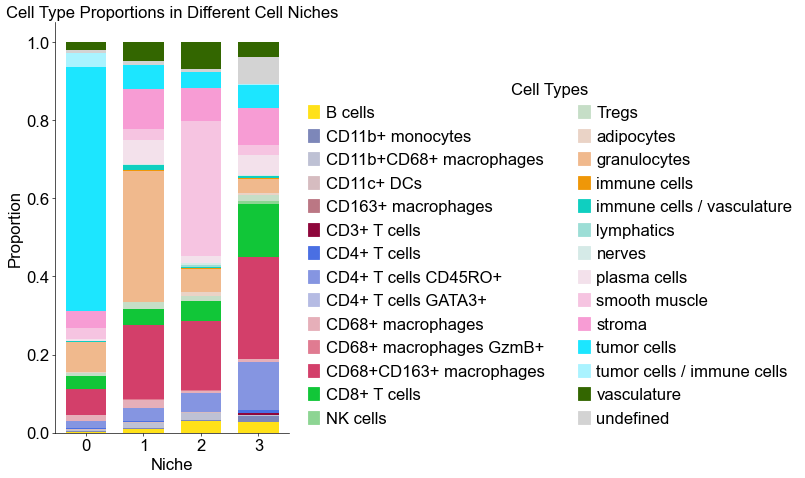

In [22]:
basic_niche_labels = adata_concat_new.uns['niche_label_summary'].copy()
ct_labels = sorted(cond_concat_new.obs['ClusterName'].unique())
basic_niche_dist = adata_concat_new.uns['niche_dist'].toarray().copy()
basic_cell_count_niche = adata_concat_new.uns['niche_cell_count'].copy()

fig, ax = plt.subplots(figsize=(5, 9))
bar_width = 0.7
n_niches, n_cell_types = basic_niche_dist.shape

x = np.arange(n_niches)

for j in range(n_cell_types):
    bottom = np.sum(basic_niche_dist[:, :j], axis=1)
    ax.bar(x,                         
           basic_niche_dist[:, j],            
           bottom=bottom,               
           width=bar_width,
           color=ct_color_dict[ct_labels[j]],
           label=ct_labels[j])

ax.set_ylabel('Proportion', fontsize=20)
ax.set_xlabel('Niche', fontsize=20)
ax.set_xticks(x)
ax.set_xticklabels(basic_niche_labels, rotation=0, ha='center')
ax.tick_params(axis='x', labelsize=20)
ax.tick_params(axis='y', labelsize=20)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.grid(False)

handles = [
    mpatches.Patch(color=color, label=ct)
    for ct, color in zip(celltypes, ct_colors)
]

ax.legend(handles=handles, title='Cell Types', loc=(1.05, 0.0), frameon=False, handleheight=0.8, 
          handlelength=0.7, ncol=2, fontsize=20, title_fontsize=20)

plt.title('Cell Type Proportions in Different Cell Niches', fontsize=20)
plt.tight_layout()
plt.show()

#### Cell type composition (case group)

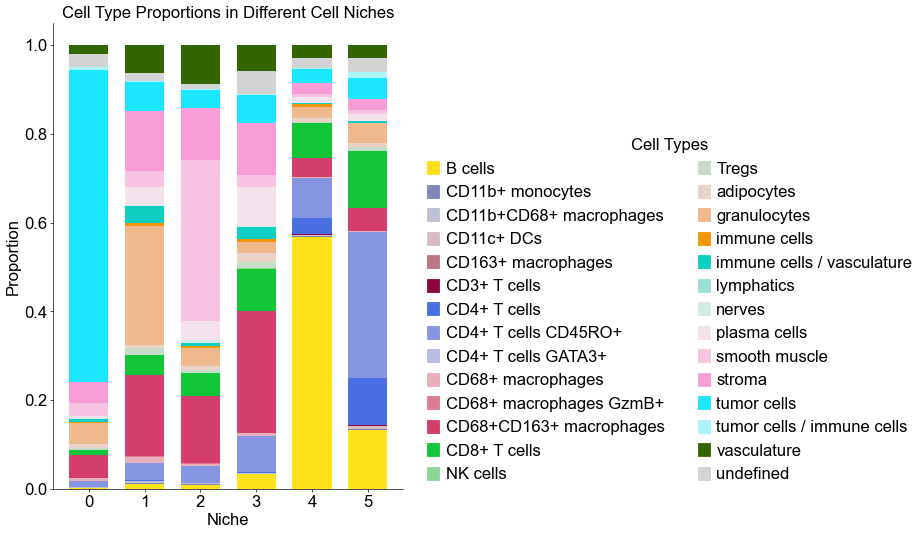

In [23]:
cond_niche_labels = cond_concat_new.uns['niche_label_summary'].copy()
ct_labels = sorted(cond_concat_new.obs['ClusterName'].unique())
cond_niche_dist = cond_concat_new.uns['niche_dist'].toarray().copy()
cond_cell_count_niche = cond_concat_new.uns['niche_cell_count'].copy()

fig, ax = plt.subplots(figsize=(16, 9))
bar_width = 0.7
n_niches, n_cell_types = cond_niche_dist.shape

x = np.arange(n_niches)

for j in range(n_cell_types):
    bottom = np.sum(cond_niche_dist[:, :j], axis=1)
    ax.bar(x,                         
           cond_niche_dist[:, j],            
           bottom=bottom,               
           width=bar_width,
           color=ct_color_dict[ct_labels[j]],
           label=ct_labels[j])

ax.set_ylabel('Proportion', fontsize=20)
ax.set_xlabel('Niche', fontsize=20)
ax.set_xticks(x)
ax.set_xticklabels(cond_niche_labels, rotation=0, ha='center')
ax.tick_params(axis='x', labelsize=20)
ax.tick_params(axis='y', labelsize=20)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.grid(False)

handles = [
    mpatches.Patch(color=color, label=ct)
    for ct, color in zip(celltypes, ct_colors)
]

ax.legend(handles=handles, title='Cell Types', loc=(1.05, 0.0), frameon=False, handleheight=0.8, 
          handlelength=0.7, ncol=2, fontsize=20, title_fontsize=20)

plt.title('Cell Type Proportions in Different Cell Niches', fontsize=20)
plt.tight_layout()
plt.show()

#### Calculate the similarity between niches from different groups
Similarities are measured using 1-JSD score

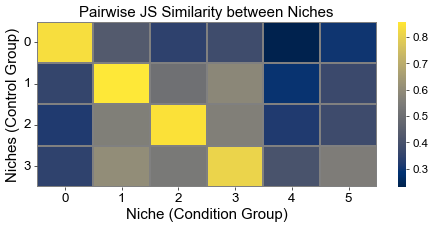

In [24]:
from scipy.spatial.distance import jensenshannon
from scipy.stats import pearsonr
from sklearn.metrics.pairwise import cosine_similarity

basic_niche_dist = adata_concat_new.uns['niche_dist'].toarray().copy()
cond_niche_dist = cond_concat_new.uns['niche_dist'].toarray().copy()

basic_niche_labels = adata_concat_new.uns['niche_label_summary'].copy()
cond_niche_labels = cond_concat_new.uns['niche_label_summary'].copy()

n_niche_basic = basic_niche_dist.shape[0]
n_niche_cond = cond_niche_dist.shape[0]

js_sim = np.zeros((n_niche_basic, n_niche_cond))
# cos_sim = cosine_similarity(basic_niche_dist, cond_niche_dist)
# corr_sim = np.zeros((n_niche_basic, n_niche_cond))

for i in range(n_niche_basic):
    for j in range(n_niche_cond):
        js_sim[i, j] = 1 - jensenshannon(basic_niche_dist[i], cond_niche_dist[j], base=2)
        # corr_sim[i, j], _ = pearsonr(basic_niche_dist[i], cond_niche_dist[j])

plt.figure(figsize=(8, 4))
sns.heatmap(
    js_sim,
    cmap='cividis',
    xticklabels=cond_niche_labels,    
    yticklabels=basic_niche_labels, 
    linewidths=0.5,
    linecolor='gray',
)
plt.xlabel("Niche (Condition Group)", fontsize=18)
plt.ylabel("Niches (Control Group)", fontsize=18)
plt.title("Pairwise JS Similarity between Niches", fontsize=18)
plt.xticks(fontsize=16, rotation=0) 
plt.yticks(fontsize=16, rotation=0)   
plt.grid(False)
plt.tight_layout()
plt.show()

### Cell type enrichment analysis

In [25]:
ct_df = ct_enrichment_test(cond_concat_new.uns['niche_dist'], 
                           cond_concat_new.uns['niche_cell_count'], 
                           cond_concat_new.uns['idx2ct'],
                           cond_concat_new.uns['niche_label_summary'],
                           method='fisher', 
                           alpha=0.05, 
                           fdr_method='fdr_by', 
                           log2fc_threshold=1,
                           prop_threshold=0.01,
                           verbose=True,
                           )
ct_df.head()

6 niches and 28 cell types in total.



,niche_idx,niche,celltype_idx,celltype,oddsratio,p-value,q-value,log2fc,prop,enrichment
0,0,0,0,B cells,0.014178,0.000000,0.000000,-5.917503,0.002095,False
1,0,0,1,CD11b+ monocytes,0.120777,0.007725,0.059068,-3.049122,0.000044,False
2,0,0,2,CD11b+CD68+ macrophages,0.646723,0.033570,0.240072,-0.627783,0.001266,False
3,0,0,3,CD11c+ DCs,0.313730,0.000005,0.000047,-1.670613,0.000567,False
4,0,0,4,CD163+ macrophages,0.134718,0.018278,0.133705,-2.891580,0.000044,False


Plot the results

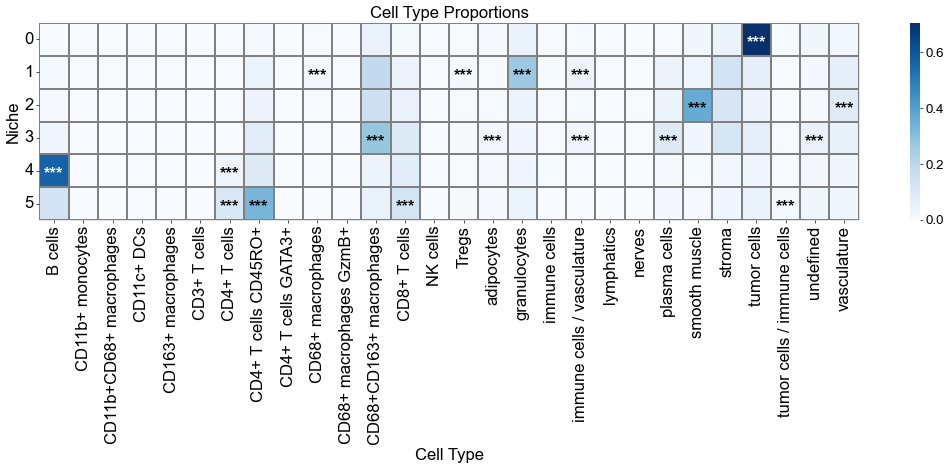

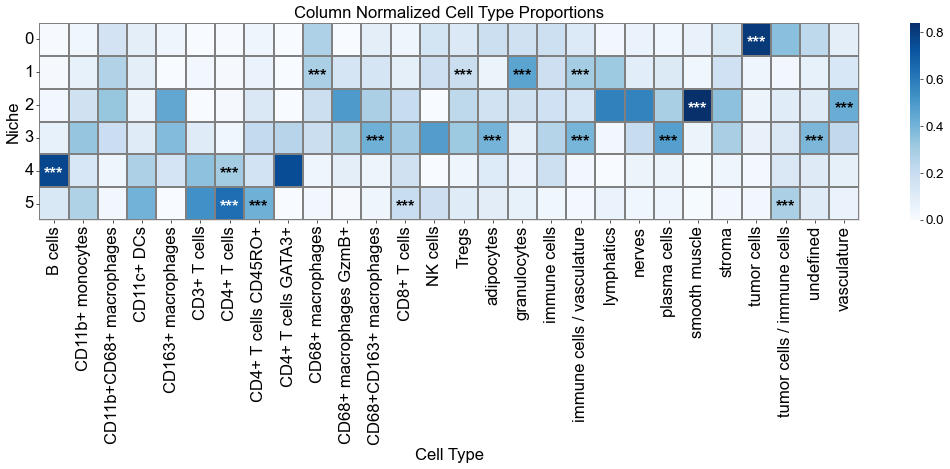

In [26]:
niche_labels = cond_concat_new.uns['niche_label_summary'].copy()
ct_labels = sorted(cond_concat_new.obs['ClusterName'].unique())

matrix_df = pd.DataFrame(
    data=cond_concat_new.uns['niche_dist'].toarray(),
    index=niche_labels,
    columns=ct_labels,
)

cn_dist_count = cond_concat_new.uns['niche_dist'].toarray() * cond_concat_new.uns['niche_cell_count'][:, np.newaxis]
cn_dist_norm = cn_dist_count / np.sum(cn_dist_count, axis=0)
matrix_df_norm = pd.DataFrame(
    data=cn_dist_norm,
    index=niche_labels,
    columns=ct_labels,
)

ct_df['stars'] = ct_df['q-value'].apply(p2stars)

stars_df = pd.DataFrame(
    '', 
    index=matrix_df.index, 
    columns=matrix_df.columns
)

for _, row in ct_df[ct_df['enrichment']].iterrows():
    niche = row['niche']
    ct    = row['celltype']
    if (niche in stars_df.index) and (ct in stars_df.columns):
        stars_df.loc[niche, ct] = row['stars']


fig, axes = plt.subplots(1, 1, figsize=(18, 8))

sns_heatmap_0 = sns.heatmap(
    matrix_df, 
    cmap='Blues', 
    # cbar_kws={'label': 'Cell type proportion'}, 
    linewidths=0.5,
    linecolor='gray',
    # square=True,
    ax=axes
)

for i, niche in enumerate(matrix_df.index):
    for j, ct in enumerate(matrix_df.columns):
        star = stars_df.iloc[i, j]
        if star:
            if matrix_df.iloc[i, j] > np.max(matrix_df.values) * 0.7:
                color='white'
            else:
                color='black'
            axes.text(j + 0.5, i + 0.6, star, ha='center', va='center', color=color, fontsize=20, fontweight='bold')

n_rows, n_cols = matrix_df.shape
axes.plot([0, n_cols], [n_rows, n_rows], color='gray', linewidth=0.5, clip_on=False) 
axes.plot([n_cols, n_cols], [0, n_rows], color='gray', linewidth=0.5, clip_on=False)  

axes.set_xticklabels(axes.get_xticklabels(), rotation=90, ha='center', fontsize=20)
axes.set_yticklabels(axes.get_yticklabels(), rotation=0, ha='right', fontsize=20)
axes.set_ylabel('Niche', fontsize=20)
axes.set_xlabel('Cell Type', fontsize=20)
axes.set_title('Cell Type Proportions', fontsize=20)
axes.collections[0].colorbar.ax.yaxis.label.set_size(20)
axes.collections[0].colorbar.ax.tick_params(labelsize=16)
axes.grid(False)

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 1, figsize=(18, 8))

sns_heatmap_1 = sns.heatmap(
    matrix_df_norm, 
    cmap='Blues', 
    # cbar_kws={'label': 'Cell type proportion'}, 
    linewidths=0.5,
    linecolor='gray',
    # square=True,
    ax=axes
)

for i, niche in enumerate(matrix_df.index):
    for j, ct in enumerate(matrix_df.columns):
        star = stars_df.iloc[i, j]
        if star:
            if matrix_df_norm.iloc[i, j] > np.max(matrix_df_norm.values) * 0.7:
                color='white'
            else:
                color='black'
            axes.text(j + 0.5, i + 0.6, star, ha='center', va='center', color=color, fontsize=20, fontweight='bold')

n_rows, n_cols = matrix_df.shape
axes.plot([0, n_cols], [n_rows, n_rows], color='gray', linewidth=0.5, clip_on=False) 
axes.plot([n_cols, n_cols], [0, n_rows], color='gray', linewidth=0.5, clip_on=False)  

axes.set_xticklabels(axes.get_xticklabels(), rotation=90, ha='center', fontsize=20)
axes.set_yticklabels(axes.get_yticklabels(), rotation=0, ha='right', fontsize=20)
axes.set_ylabel('Niche', fontsize=20)
axes.set_xlabel('Cell Type', fontsize=20)
axes.set_title('Column Normalized Cell Type Proportions', fontsize=20)
axes.collections[0].colorbar.ax.yaxis.label.set_size(20)
axes.collections[0].colorbar.ax.tick_params(labelsize=16)
axes.grid(False)

plt.tight_layout()
plt.show()

### Niche-niche co-localization analysis

In [27]:
nnc_results = nnc_enrichment_test(cond_list, 
                                  'niche_label', 
                                  niche_summary=cond_concat_new.uns['niche_label_summary'],  
                                  spatial_key='spatial', 
                                  cut_percentage=99, 
                                  method='fisher', 
                                  alpha=0.05, 
                                  fdr_method='fdr_by', 
                                  log2fc_threshold=1,
                                  prop_threshold=0.01, 
                                  verbose=True,
                                  )
nnc_df, edge_prop_mtx, n1_count = nnc_results
nnc_df.head()

6 niches in total.



,niche1_idx,niche1,niche2_idx,niche2,edge_count,edge_prop,oddsratio,p-value,q-value,log2fc,enrichment
0,0,0,1,1,1923.0,0.314062,2.444105,2.455301e-177,2.452224e-176,0.993179,False
1,0,0,2,2,1837.0,0.300016,1.567754,1.009133e-48,5.039340e-48,0.482764,False
2,0,0,3,3,2111.0,0.344766,1.282938,7.294987e-18,3.122505e-17,0.245362,False
3,0,0,4,4,89.0,0.014535,0.135496,7.704461e-149,5.129870e-148,-2.755726,False
4,0,0,5,5,163.0,0.026621,0.203515,6.387030e-141,3.827415e-140,-2.153811,False


Plot the results

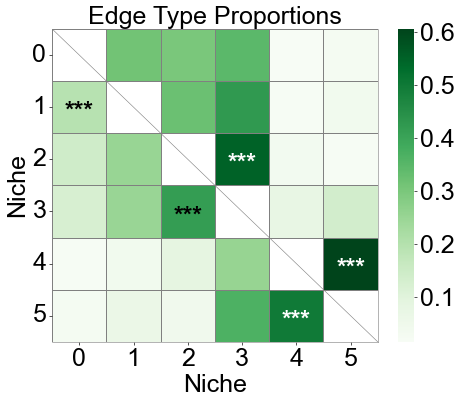

In [28]:
niche_labels = cond_concat_new.uns['niche_label_summary'].copy()

nnc_df['stars'] = nnc_df['q-value'].apply(p2stars)

matrix_df = pd.DataFrame(
    data=edge_prop_mtx,
    index=niche_labels,
    columns=niche_labels,
)

for i in range(matrix_df.shape[0]):
    for j in range(matrix_df.shape[1]):
        if i == j:
            matrix_df.iloc[i, j] = np.nan

stars_df = pd.DataFrame(
    '', 
    index=matrix_df.index, 
    columns=matrix_df.columns
)

for _, row in nnc_df[nnc_df['enrichment']].iterrows():
    n1 = row['niche1']
    n2 = row['niche2']
    if (n1 in stars_df.index) and (n2 in stars_df.columns):
        stars_df.loc[n1, n2] = row['stars']

plt.figure(figsize=(8, 7))

ax  = sns.heatmap(
    matrix_df, 
    cmap='Greens', 
    # cbar_kws={'label': 'Edge type proportion'}, 
    linewidths=0.7,
    linecolor='gray',
    # square=True,
)

for i, n1 in enumerate(matrix_df.index):
    for j, n2 in enumerate(matrix_df.columns):
        if i == j:
            ax.plot([i, i+1], [i, i+1], color='gray', linewidth=0.7)
            # ax.plot([i+1, i], [i, i+1], color='gray', linewidth=0.7)
            continue
        star = stars_df.iloc[i, j]
        if star:
            if matrix_df.iloc[i, j] > np.nanmax(matrix_df.values) * 0.7:
                color='white'
            else:
                color='black'
            ax.text(j + 0.5, i + 0.6, star, ha='center', va='center', color=color, fontsize=30, fontweight='bold')

n_rows, n_cols = matrix_df.shape
ax.plot([0, n_cols], [n_rows, n_rows], color='gray', linewidth=0.7, clip_on=False) 
ax.plot([n_cols, n_cols], [0, n_rows], color='gray', linewidth=0.7, clip_on=False)  

ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center', fontsize=30)
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right', fontsize=30)
ax.set_ylabel('Niche', fontsize=30)
ax.set_xlabel('Niche', fontsize=30)
ax.set_title('Edge Type Proportions', fontsize=30)
ax.collections[0].colorbar.ax.yaxis.label.set_size(30)
ax.collections[0].colorbar.ax.tick_params(labelsize=30)
ax.grid(False)

plt.tight_layout()
plt.show()